# NAME: ARYAMAN SHARDUL
# EECE 7150 Homework 4

In [1]:
import os, sys
os.environ["OMP_NUM_THREADS"] = "1"
os.environ["MKL_THREADING_LAYER"] = "GNU"
print(sys.executable)
import gtsam
from gtsam import symbol
import importlib, subprocess, site
try:
    import matplotlib_inline 
except ModuleNotFoundError:
    subprocess.run([sys.executable, "-m", "pip", "install", "--user", "matplotlib-inline>=0.1.7"], check=False)
    importlib.invalidate_caches()
    user_site = site.getusersitepackages()
    if user_site not in sys.path:
        sys.path.insert(0, user_site)
    import matplotlib_inline

import matplotlib
matplotlib.rcParams["backend"] = "module://matplotlib_inline.backend_inline"
from mpl_toolkits.mplot3d import Axes3D  
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
import glob, json, math
import numpy as np
import cv2
from dataclasses import dataclass
from typing import List, Tuple, Dict
from scipy.optimize import least_squares
from matplotlib.patches import Ellipse
import re
from collections import defaultdict, deque
import numbers, copy

print("Matplotlib version:", matplotlib.__version__)
print("Matplotlib backend:", matplotlib.get_backend())


/usr/bin/python3
Matplotlib version: 3.5.1
Matplotlib backend: module://matplotlib_inline.backend_inline


In [2]:
Input_Dir = "buddha_images"         

def list_images(folder, exts=(".png",".jpg",".jpeg",".tif",".tiff")):
    files = sorted([p for p in glob.glob(os.path.join(folder, "*")) if p.lower().endswith(exts)])
    assert files, f"No images found in {folder}"
    return files
input_imgs = list_images(Input_Dir)


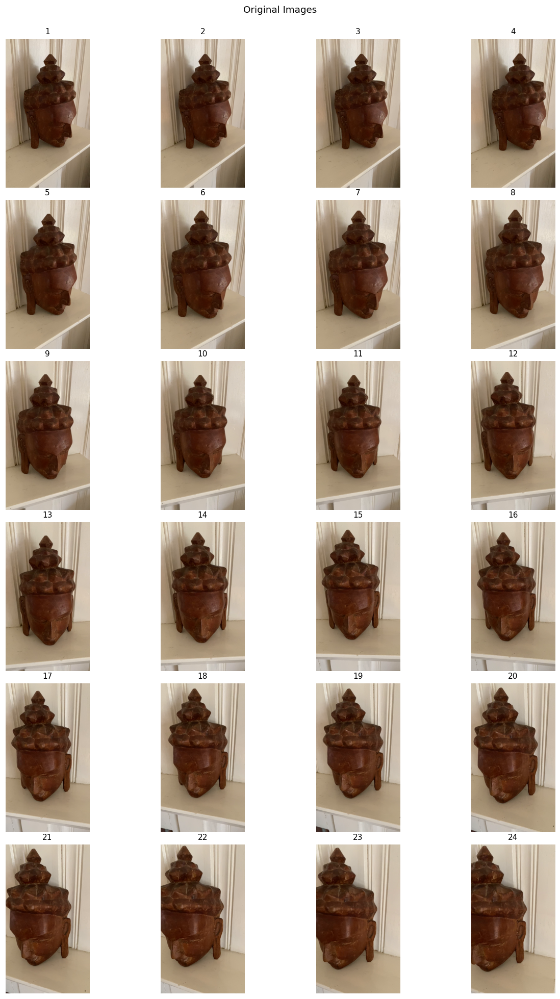

(<Figure size 1320x1980 with 24 Axes>,
 array([[<AxesSubplot:title={'center':'1'}>,
         <AxesSubplot:title={'center':'2'}>,
         <AxesSubplot:title={'center':'3'}>,
         <AxesSubplot:title={'center':'4'}>],
        [<AxesSubplot:title={'center':'5'}>,
         <AxesSubplot:title={'center':'6'}>,
         <AxesSubplot:title={'center':'7'}>,
         <AxesSubplot:title={'center':'8'}>],
        [<AxesSubplot:title={'center':'9'}>,
         <AxesSubplot:title={'center':'10'}>,
         <AxesSubplot:title={'center':'11'}>,
         <AxesSubplot:title={'center':'12'}>],
        [<AxesSubplot:title={'center':'13'}>,
         <AxesSubplot:title={'center':'14'}>,
         <AxesSubplot:title={'center':'15'}>,
         <AxesSubplot:title={'center':'16'}>],
        [<AxesSubplot:title={'center':'17'}>,
         <AxesSubplot:title={'center':'18'}>,
         <AxesSubplot:title={'center':'19'}>,
         <AxesSubplot:title={'center':'20'}>],
        [<AxesSubplot:title={'center':'21'}>,

In [3]:
def show_image_grid(items, cols=4, title=None, captions=None, fontsize=10, dpi=110):
    # Display images
    n = len(items)
    rows = math.ceil(n / cols)
    fig, axes = plt.subplots(rows, cols, figsize=(3*cols, 3*rows), dpi=dpi, squeeze=False)
    flat_axes = axes.ravel()

    for i, ax in enumerate(flat_axes):
        if i < n:
            x = items[i]
            img = mpimg.imread(x) if isinstance(x, (str, bytes, os.PathLike)) else x
            is_gray = (img.ndim == 2) or (img.ndim == 3 and img.shape[-1] == 1)
            ax.imshow(img, cmap='gray' if is_gray else None)
            ax.axis('off')
            cap = captions[i] if (captions is not None and i < len(captions)) else ""
            ax.set_title(f"{i+1}. {cap}" if cap else f"{i+1}", fontsize=fontsize)
        else:
            ax.axis('off')

    if title:
        fig.suptitle(title, fontsize=fontsize+2)
        fig.tight_layout(pad=0.2, rect=[0, 0, 1, 0.97])
    else:
        fig.tight_layout(pad=0.2)

    plt.show()
    return fig, axes

# Display input images
show_image_grid(input_imgs,4, "Original Images")

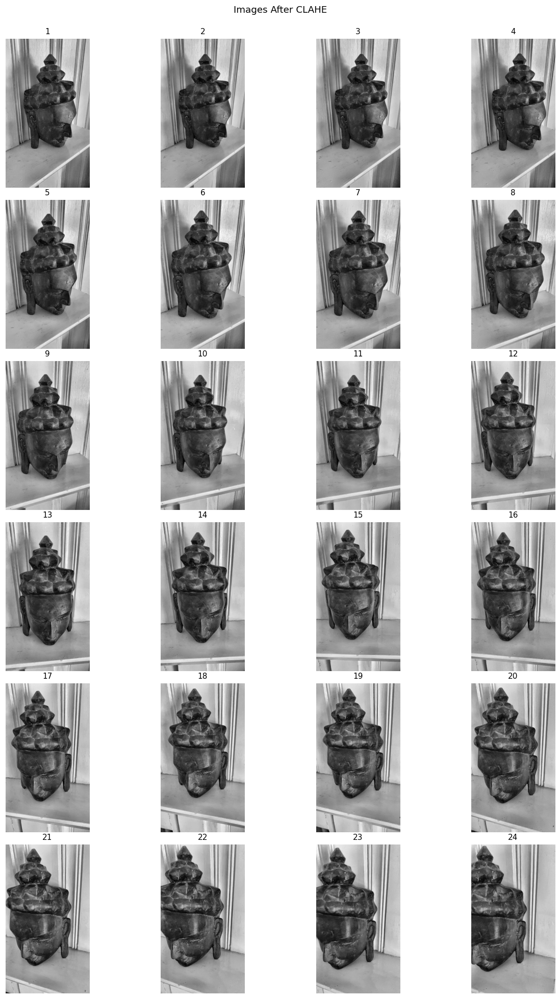

(<Figure size 1320x1980 with 24 Axes>,
 array([[<AxesSubplot:title={'center':'1'}>,
         <AxesSubplot:title={'center':'2'}>,
         <AxesSubplot:title={'center':'3'}>,
         <AxesSubplot:title={'center':'4'}>],
        [<AxesSubplot:title={'center':'5'}>,
         <AxesSubplot:title={'center':'6'}>,
         <AxesSubplot:title={'center':'7'}>,
         <AxesSubplot:title={'center':'8'}>],
        [<AxesSubplot:title={'center':'9'}>,
         <AxesSubplot:title={'center':'10'}>,
         <AxesSubplot:title={'center':'11'}>,
         <AxesSubplot:title={'center':'12'}>],
        [<AxesSubplot:title={'center':'13'}>,
         <AxesSubplot:title={'center':'14'}>,
         <AxesSubplot:title={'center':'15'}>,
         <AxesSubplot:title={'center':'16'}>],
        [<AxesSubplot:title={'center':'17'}>,
         <AxesSubplot:title={'center':'18'}>,
         <AxesSubplot:title={'center':'19'}>,
         <AxesSubplot:title={'center':'20'}>],
        [<AxesSubplot:title={'center':'21'}>,

In [4]:
def normalize_intensity(imgs):
    # Convert images to grayscale and use CLAHE
    out = []
    clahe = cv2.createCLAHE(clipLimit=2.0, tileGridSize=(8,8))
    for p in imgs:
        img_bgr = cv2.imread(p)                        # BGR
        gray = cv2.cvtColor(img_bgr, cv2.COLOR_BGR2GRAY)
        out.append(clahe.apply(gray))
    return out

# Display images after CLAHE
normalized_intensity_images = normalize_intensity(input_imgs)
show_image_grid(normalized_intensity_images,4, "Images After CLAHE")

In [5]:
def rootsift(desc):
    # L1 normalize then sqrt, as in RootSIFT
    if desc is None: return None
    desc = desc.astype(np.float32)
    desc /= (desc.sum(axis=1, keepdims=True) + 1e-12)
    return np.sqrt(desc)

def detect_and_describe(img_gray, use_rootsift=True):
    # Dectect keypoints and generate descriptors using SIFT
    sift = cv2.SIFT_create(nfeatures=4000, contrastThreshold=0.01, edgeThreshold=10, sigma=1.2)
    kpts, desc = sift.detectAndCompute(img_gray, None)
    if use_rootsift and desc is not None:
        desc = rootsift(desc)
    return kpts, desc

def match_descriptors_with_points(kptsA, descA, kptsB, descB, ratio=0.75):
    if descA is None or descB is None or len(descA) == 0 or len(descB) == 0:
        return [], np.empty((0,2), np.float32), np.empty((0,2), np.float32)

    # FLANN (KD-tree) for SIFT
    index_params  = dict(algorithm=1, trees=8)
    search_params = dict(checks=128)
    flann = cv2.FlannBasedMatcher(index_params, search_params)

    # A -> B with ratio test, keep best per queryIdx
    bestA = {}
    for pair in flann.knnMatch(descA, descB, k=2):
        if len(pair) < 2: 
            continue
        m, n = pair
        if m.distance < ratio * n.distance:
            prev = bestA.get(m.queryIdx)
            if prev is None or m.distance < prev[0]:
                bestA[m.queryIdx] = (m.distance, m.trainIdx)

    # B -> A with ratio test, keep best per queryIdx
    bestB = {}
    for pair in flann.knnMatch(descB, descA, k=2):
        if len(pair) < 2:
            continue
        m, n = pair
        if m.distance < ratio * n.distance:
            prev = bestB.get(m.queryIdx)
            if prev is None or m.distance < prev[0]:
                bestB[m.queryIdx] = (m.distance, m.trainIdx)

    # Symmetric check
    pairs = []
    for qa, (_, tb) in bestA.items():   # qa: idx in A, tb: idx in B
        qb = tb                          # qb: idx in B
        if qb in bestB and bestB[qb][1] == qa:
            pairs.append((qa, tb))

    # Build pixel coordinate arrays (Nx2) in float32
    ptsA = np.array([kptsA[i].pt for (i, j) in pairs], dtype=np.float32)
    ptsB = np.array([kptsB[j].pt for (i, j) in pairs], dtype=np.float32)

    return pairs, ptsA, ptsB


In [6]:
# Hartley normalization per image
def _hartley_normalize_xy(xy):         
    c = xy.mean(axis=0)
    xc = xy - c
    mean_dist = np.mean(np.linalg.norm(xc, axis=1))
    s = np.sqrt(2.0) / (mean_dist + 1e-12)
    T = np.array([[s, 0, -s*c[0]],
                  [0, s, -s*c[1]],
                  [0, 0, 1]], dtype=float)
    ones = np.ones((xy.shape[0], 1))
    xh = np.hstack([xy, ones])          
    xh_n = (T @ xh.T).T                  
    return xh_n, T

    
def _enforce_rank2_F(F):
    U, S, Vt = np.linalg.svd(F)
    S[-1] = 0.0
    return U @ np.diag(S) @ Vt

# Normalized 8-point
def eight_point_F(pts1, pts2):
    assert pts1.shape == pts2.shape and pts1.shape[0] >= 8
    # Normalize each side
    x1n, T1 = _hartley_normalize_xy(pts1)
    x2n, T2 = _hartley_normalize_xy(pts2)

    # Build A (N x 9) with normalized homogeneous points
    u1, v1 = x1n[:,0], x1n[:,1]
    u2, v2 = x2n[:,0], x2n[:,1]
    A = np.stack([u2*u1, u2*v1, u2, v2*u1, v2*v1, v2, u1, v1, np.ones_like(u1)], axis=1)

    # Solve Af=0 with SVD (f is 9-vector)
    _, _, Vt = np.linalg.svd(A, full_matrices=False)
    F_norm = Vt[-1].reshape(3,3)

    # Rank-2 on normalized F
    F_norm = _enforce_rank2_F(F_norm)

    # Denormalize
    F = T2.T @ F_norm @ T1
    # Final rank-2
    F = _enforce_rank2_F(F)
    return F
    
def sampson_errors(F, pts1, pts2):
    # Sampson distance per correspondence (pixel coords)
    x1 = np.hstack([pts1, np.ones((pts1.shape[0],1), dtype=np.float64)])
    x2 = np.hstack([pts2, np.ones((pts2.shape[0],1), dtype=np.float64)])
    Fx1 = (F @ x1.T).T
    Ftx2 = (F.T @ x2.T).T
    x2tFx1 = np.sum(x2 * (F @ x1.T).T, axis=1)
    denom = Fx1[:,0]**2 + Fx1[:,1]**2 + Ftx2[:,0]**2 + Ftx2[:,1]**2
    denom = np.clip(denom, 1e-12, None)
    return (x2tFx1**2) / denom


# RANSAC for F using 8-point + Sampson residual
def ransac_F_eight_point(pts1, pts2, thresh_px=1.0, max_iters=5000, confidence=0.999, rng_seed=None):
    assert pts1.shape == pts2.shape and pts1.shape[0] >= 8
    N = pts1.shape[0]
    rng = np.random.default_rng(rng_seed)

    best_F = None
    best_inliers = None
    best_inlier_count = -1

    # Convert pixel threshold (px) to squared Sampson threshold (px^2)
    thr2 = float(thresh_px)**2

    # Adaptive RANSAC loop
    it = 0
    max_adaptive = max_iters
    while it < max_adaptive:
        # 1) sample 8 distinct correspondences
        idx = rng.choice(N, size=8, replace=False)
        try:
            F_cand = eight_point_F(pts1[idx], pts2[idx])
        except np.linalg.LinAlgError:
            it += 1
            continue

        # 2) score all points with Sampson error
        errs2 = sampson_errors(F_cand, pts1, pts2)
        inliers = errs2 < thr2
        n_inl = int(inliers.sum())

        # 3) update best & adapt iteration count
        if n_inl > best_inlier_count:
            best_F = F_cand
            best_inliers = inliers
            best_inlier_count = n_inl

            # Update required iterations given inlier ratio
            eps = 1.0 - (n_inl / N)
            eps = np.clip(eps, 1e-9, 1-1e-9)
            num = np.log(1.0 - confidence)
            den = np.log(1.0 - (1.0 - eps)**8)  # 8-point
            if den != 0:
                max_adaptive = min(max_adaptive, int(np.ceil(num / den)))
                max_adaptive = max(100, max_adaptive) 

        it += 1

    if best_F is None:
        # Fall back to a single 8-point on all points
        best_F = eight_point_F(pts1, pts2)
        best_inliers = np.ones(N, dtype=bool)

    # Final refit on best inliers
    if best_inliers.sum() >= 8:
        best_F = eight_point_F(pts1[best_inliers], pts2[best_inliers])

    return best_F, best_inliers



# Convenience: E from F
def E_from_F(F, K1, K2):
    E = K2.T @ F @ K1
    U, S, Vt = np.linalg.svd(E)
    # Fix handedness so R ∈ SO(3)
    if np.linalg.det(U @ Vt) < 0:
        Vt = -Vt
    # Project to essential manifold (1,1,0)
    E = U @ np.diag([1, 1, 0]) @ Vt
    return E


# Draw all keypoints (small dots) and inlier match lines on a stitched image
def visualize_pair(img1_gray, img2_gray, kpts1, kpts2, inlier_pairs):
    im1 = np.dstack([img1_gray]*3)
    im2 = np.dstack([img2_gray]*3)
    h1, w1 = im1.shape[:2]
    h2, w2 = im2.shape[:2]
    H = max(h1, h2)
    canvas = np.zeros((H, w1 + w2, 3), dtype=np.uint8)
    canvas[:h1, :w1] = im1
    canvas[:h2, w1:w1+w2] = im2

    for kp in kpts1:
        u, v = kp.pt
        u, v = int(round(u)), int(round(v))
        if 0 <= v < h1 and 0 <= u < w1:
            canvas[v, u] = (0, 255, 0)
    for kp in kpts2:
        u, v = kp.pt
        u, v = int(round(u + w1)), int(round(v))
        if 0 <= v < h2 and 0 <= u < w1 + w2:
            canvas[v, u] = (0, 255, 0)

    for (ia, ib) in inlier_pairs:
        u1, v1 = kpts1[ia].pt
        u2, v2 = kpts2[ib].pt
        x1, y1 = u1, v1
        x2, y2 = u2 + w1, v2
        color = tuple(np.random.randint(0, 255, size=3).tolist())
        cv2.line(canvas, (int(round(x1)), int(round(y1))),
                          (int(round(x2)), int(round(y2))), color, 1, cv2.LINE_AA)
        cv2.circle(canvas, (int(round(x1)), int(round(y1))), 2, color, -1, cv2.LINE_AA)
        cv2.circle(canvas, (int(round(x2)), int(round(y2))), 2, color, -1, cv2.LINE_AA)

    return canvas

In [7]:
def _enforce_essential(E):
    # Make E rank-2 with equal first two singular values: U diag(1,1,0) V^T
    U, S, Vt = np.linalg.svd(E)
    # Guard against reflection
    if np.linalg.det(U) < 0: U[:, -1] *= -1
    if np.linalg.det(Vt) < 0: Vt[-1, :] *= -1
    E_fix = U @ np.diag([1.0, 1.0, 0.0]) @ Vt
    return E_fix

def _decompose_E(E):
    # Hartley W matrix
    W = np.array([[0, -1, 0],
                  [1,  0, 0],
                  [0,  0, 1]], dtype=float)
    U, _, Vt = np.linalg.svd(E)
    # Ensure rotations are proper (det=+1)
    R1 = U @ W  @ Vt
    R2 = U @ W.T @ Vt
    if np.linalg.det(R1) < 0: R1 *= -1
    if np.linalg.det(R2) < 0: R2 *= -1
    t = U[:, 2]
    t = t / np.linalg.norm(t)
    # Four candidates
    return [(R1,  t), (R1, -t), (R2,  t), (R2, -t)]

def _linear_triangulate_batch(x1, x2, R, t):
    # Triangulate in normalized coords.
    N = x1.shape[0]
    X = np.empty((N, 3), dtype=float)

    P0 = np.hstack([np.eye(3), np.zeros((3, 1))])
    P1 = np.hstack([R, t.reshape(3, 1)])

    for i in range(N):
        u1, v1 = x1[i]
        u2, v2 = x2[i]

        A = np.vstack([
            u1 * P0[2] - P0[0],
            v1 * P0[2] - P0[1],
            u2 * P1[2] - P1[0],
            v2 * P1[2] - P1[1],
        ])
        _, _, Vt = np.linalg.svd(A)
        Xh = Vt[-1]
        Xh /= Xh[3]
        X[i] = Xh[:3]
    return X

def _reproj_error_norm(x, X, P):
    N = X.shape[0]
    Xh = np.hstack([X, np.ones((N,1))])   
    proj = (P @ Xh.T).T                    
    proj = proj[:, :2] / proj[:, 2:3]      # divide by z
    err = np.linalg.norm(proj - x, axis=1) # L2 in normalized plane
    return err

def recover_pose_from_E_numpy(E_in, pts1_px, pts2_px, K, reproj_thresh_norm=2e-3, min_parallax_deg=0.0):
    # Pure NumPy pose recovery from Essential matrix.
    E = _enforce_essential(E_in.astype(float))

    # Normalize to camera coordinates
    Kinv = np.linalg.inv(K)
    pts1_h = np.hstack([pts1_px, np.ones((pts1_px.shape[0], 1))])
    pts2_h = np.hstack([pts2_px, np.ones((pts2_px.shape[0], 1))])
    x1 = (Kinv @ pts1_h.T).T[:, :2] / (Kinv @ pts1_h.T).T[:, 2:3]
    x2 = (Kinv @ pts2_h.T).T[:, :2] / (Kinv @ pts2_h.T).T[:, 2:3]

    candidates = _decompose_E(E)

    best_count = -1
    best = None

    # Camera matrices in normalized coords
    P0 = np.hstack([np.eye(3), np.zeros((3,1))])

    for (R, t) in candidates:
        # Triangulate
        X = _linear_triangulate_batch(x1, x2, R, t)

        # Depth checks (cheirality)
        z1 = X[:, 2]                                    # in cam0
        X2 = (R @ X.T + t.reshape(3,1)).T               # in cam1
        z2 = X2[:, 2]

        front = (z1 > 0) & (z2 > 0)

        # Reprojection error checks (in normalized plane)
        P1 = np.hstack([R, t.reshape(3,1)])
        err1 = _reproj_error_norm(x1, X, P0)
        err2 = _reproj_error_norm(x2, X, P1)
        good_err = (err1 < reproj_thresh_norm) & (err2 < reproj_thresh_norm)

        mask = front & good_err

        # Optional parallax filter (angle between rays)
        if min_parallax_deg > 0.0:
            # Bearing vectors
            b1 = np.hstack([x1, np.ones((x1.shape[0], 1))])
            b1 /= np.linalg.norm(b1, axis=1, keepdims=True)
            b2 = np.hstack([x2, np.ones((x2.shape[0], 1))])
            b2 /= np.linalg.norm(b2, axis=1, keepdims=True)
            # angle at cam0
            cosang = np.sum(b1 * (R.T @ b2.T).T, axis=1)
            cosang = np.clip(cosang, -1.0, 1.0)
            angdeg = np.degrees(np.arccos(cosang))
            mask = mask & (angdeg >= min_parallax_deg)

        count = int(mask.sum())
        if count > best_count:
            best_count = count
            best = (R, t, mask, X)

    if best is None:
        return np.eye(3), np.array([1,0,0], float), np.zeros(len(pts1_px), dtype=bool), np.zeros((len(pts1_px),3))

    R_best, t_best, mask_best, X_best = best
    return R_best, t_best, mask_best, X_best


Image size (W,H): 1080 1920
K principal point (cx, cy): 540.0 960.0
[pair 1-2] matches=625  F-inliers=578


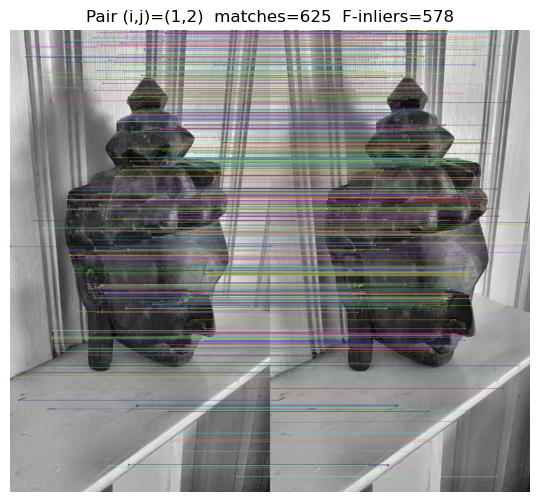

recover_pose_numpy: cheirality_inliers = 0 / 578  (det(R)=1.000)

=== Pair (i,j)=(1,2) ===
F =
 [[-2.10525756e-09 -3.47721459e-07  2.43242949e-03]
 [ 3.49277053e-07 -2.84029753e-10 -7.81988212e-04]
 [-2.43157087e-03  7.81411611e-04  2.17220507e-03]]
E =
 [[ 5.32883250e-04  2.64269171e-01 -9.28042919e-01]
 [-2.64798797e-01  2.04119142e-04  2.62357549e-01]
 [ 9.27838612e-01 -2.62798655e-01  5.57532272e-04]]
[pair 1-3] matches=336  F-inliers=221


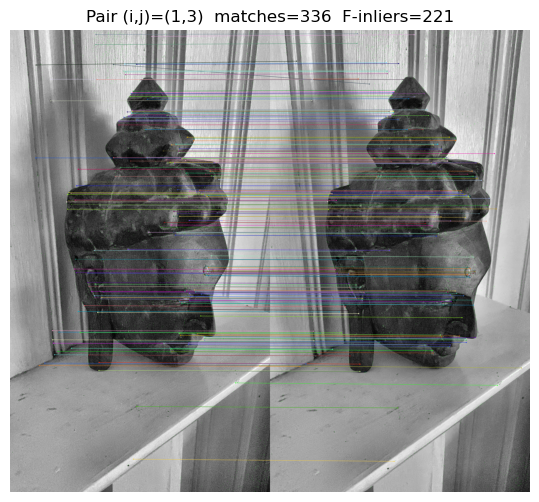

recover_pose_numpy: cheirality_inliers = 1 / 221  (det(R)=1.000)

=== Pair (i,j)=(1,3) ===
F =
 [[-9.61682644e-09 -5.47067727e-06  4.78839076e-03]
 [ 5.44762244e-06 -7.29762747e-09 -1.21161180e-03]
 [-4.78100349e-03  1.25270830e-03 -2.70302355e-02]]
E =
 [[ 1.30442538e-03  9.82661045e-01  4.89861848e-02]
 [-9.82346028e-01  1.78712031e-03 -1.81076722e-01]
 [-4.66928723e-02  1.78885262e-01  2.62581820e-04]]
[pair 1-4] matches=255  F-inliers=147


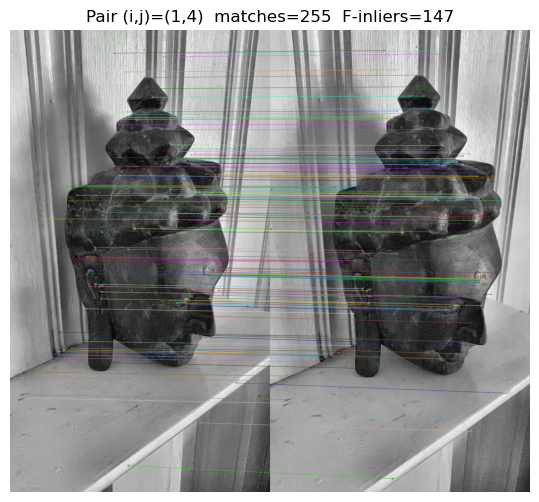

recover_pose_numpy: cheirality_inliers = 146 / 147  (det(R)=1.000)

=== Pair (i,j)=(1,4) ===
F =
 [[-4.94415935e-10 -2.63416640e-06  7.91960851e-04]
 [ 2.67205475e-06 -3.92864151e-08 -3.50732156e-03]
 [-7.88898737e-04  3.70847054e-03 -7.50454957e-02]]
E =
 [[ 2.02797776e-04 -8.44953838e-01 -3.24927096e-01]
 [ 8.58952798e-01 -1.27079072e-02 -3.93883169e-01]
 [ 3.32569165e-01  4.20294526e-01  1.09665672e-02]]
[pair 1-5] matches=163  F-inliers=81


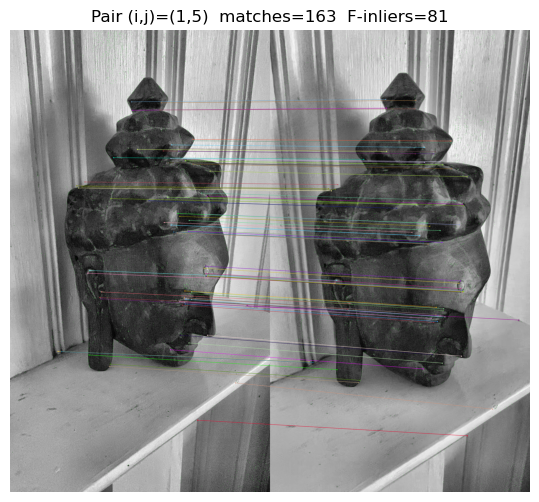

recover_pose_numpy: cheirality_inliers = 78 / 81  (det(R)=1.000)

=== Pair (i,j)=(1,5) ===
F =
 [[ 2.32822798e-08  1.42823966e-06 -5.93334794e-04]
 [-1.53048879e-06  4.62134656e-08  3.74783605e-03]
 [ 5.57905832e-04 -3.95199493e-03  1.10778973e-01]]
E =
 [[-0.00833542 -0.60043156 -0.19528179]
 [ 0.65003057 -0.02054926 -0.73446826]
 [ 0.2204875   0.76813537  0.01500576]]
[pair 1-6] matches=126  F-inliers=59
[pair 1-7] matches=96  F-inliers=31
[pair 1-8] matches=73  F-inliers=17
[pair 2-3] matches=527  F-inliers=363


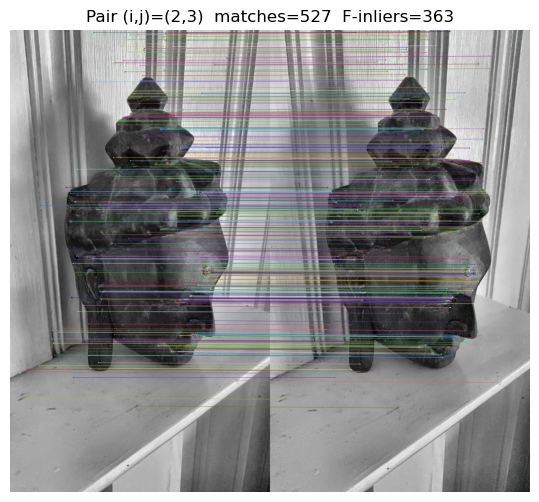

recover_pose_numpy: cheirality_inliers = 0 / 363  (det(R)=1.000)

=== Pair (i,j)=(2,3) ===
F =
 [[ 1.90890714e-08  2.73107279e-06 -2.64943826e-03]
 [-2.70827879e-06  4.80476564e-09 -7.38364153e-04]
 [ 2.63199810e-03  7.14013469e-04  1.90059822e-02]]
E =
 [[ 4.03697356e-03  9.05665158e-01 -4.42764985e-03]
 [-9.04072532e-01  4.40666844e-03 -4.27323868e-01]
 [ 7.14824778e-03  4.23923580e-01  4.12896170e-04]]
[pair 2-4] matches=442  F-inliers=281


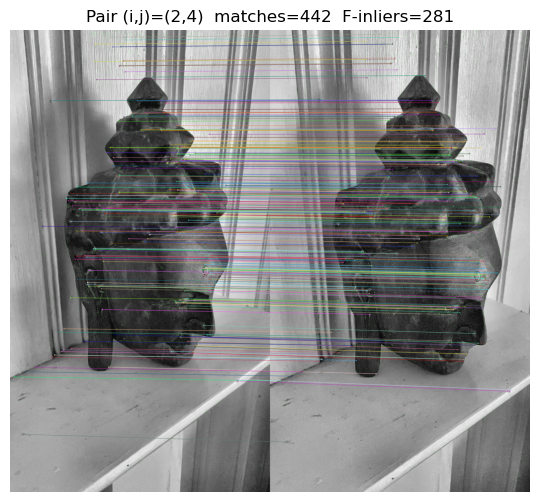

recover_pose_numpy: cheirality_inliers = 274 / 281  (det(R)=1.000)

=== Pair (i,j)=(2,4) ===
F =
 [[-1.05933925e-08  2.36442543e-06 -7.69015078e-05]
 [-2.40808383e-06  2.75252995e-08  3.41117122e-03]
 [ 7.00297040e-05 -3.57719914e-03  3.98247294e-02]]
E =
 [[-0.00599726  0.78753505  0.42587083]
 [-0.80153828  0.01175055  0.41601435]
 [-0.43460658 -0.44004021 -0.01409628]]
[pair 2-5] matches=315  F-inliers=173


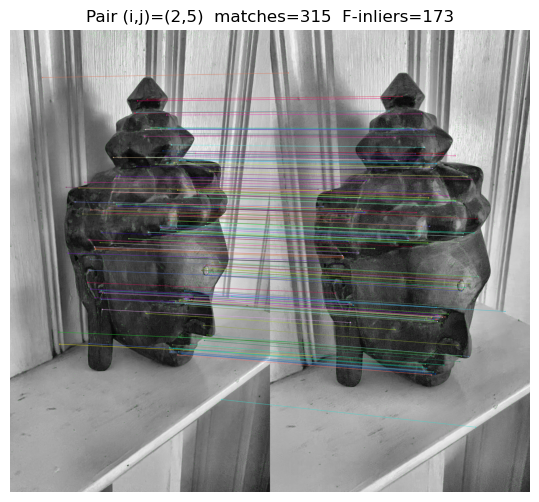

recover_pose_numpy: cheirality_inliers = 35 / 173  (det(R)=1.000)

=== Pair (i,j)=(2,5) ===
F =
 [[-3.08558182e-08  6.82679489e-08  6.33476609e-04]
 [-1.98235426e-07  3.62741090e-08  2.93284635e-03]
 [-6.32706709e-04 -3.14746418e-03  1.38681067e-01]]
E =
 [[ 0.01905038 -0.03511669 -0.23002489]
 [ 0.11708034 -0.0128242  -0.96574672]
 [ 0.26420103  0.9638565   0.01148555]]
[pair 2-6] matches=230  F-inliers=93


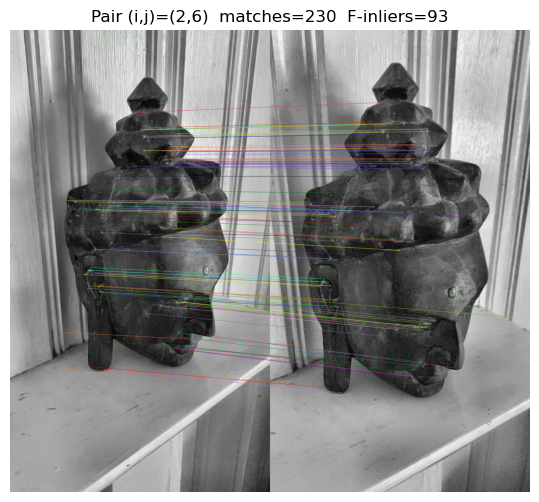

recover_pose_numpy: cheirality_inliers = 15 / 93  (det(R)=1.000)

=== Pair (i,j)=(2,6) ===
F =
 [[-8.29240298e-09  3.62022472e-07 -6.46099858e-06]
 [-6.22594342e-07  8.74870303e-08  2.96752908e-03]
 [ 3.29959488e-05 -3.34307290e-03  2.68162047e-01]]
E =
 [[-0.0068914   0.19416975  0.11126932]
 [-0.36582403  0.03674035  0.92278832]
 [-0.18467156 -0.96381163 -0.01086089]]
[pair 2-7] matches=169  F-inliers=60
[pair 2-8] matches=114  F-inliers=23
[pair 2-9] matches=72  F-inliers=12
[pair 2-10] matches=71  F-inliers=9
[pair 3-4] matches=441  F-inliers=302


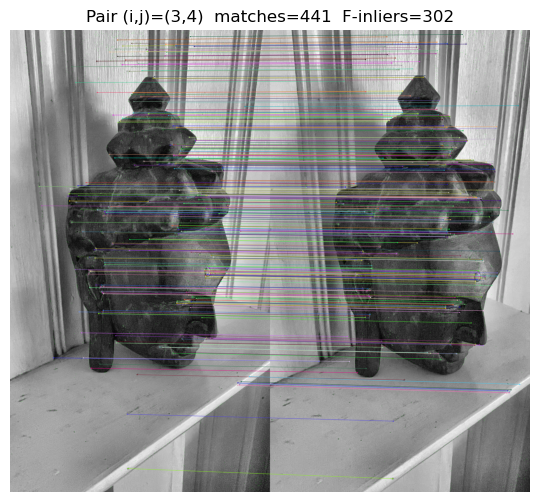

recover_pose_numpy: cheirality_inliers = 200 / 302  (det(R)=1.000)

=== Pair (i,j)=(3,4) ===
F =
 [[-3.81376897e-08  3.42730746e-07  2.19925695e-03]
 [-3.54926974e-07  5.02570977e-09  1.15241753e-03]
 [-2.21453404e-03 -1.16435341e-03 -6.17249476e-02]]
E =
 [[ 0.02275764 -0.21366687 -0.90963236]
 [ 0.21605939 -0.00480792 -0.34974913]
 [ 0.91470718  0.34668204  0.02215047]]
[pair 3-5] matches=274  F-inliers=155


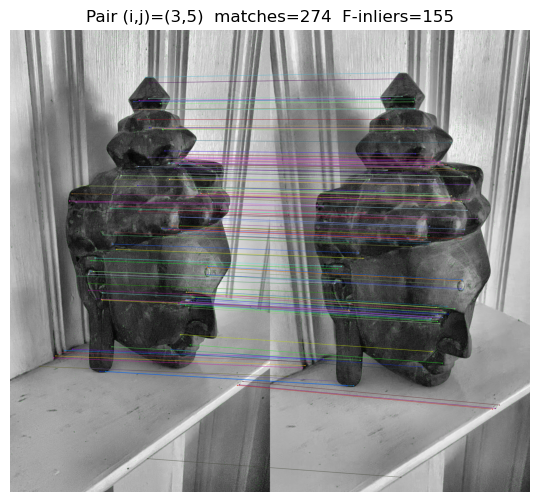

recover_pose_numpy: cheirality_inliers = 146 / 155  (det(R)=1.000)

=== Pair (i,j)=(3,5) ===
F =
 [[-3.98634859e-09  9.77403872e-07 -1.25112915e-04]
 [-1.09318816e-06  4.87500695e-08  3.34258475e-03]
 [ 1.30978728e-04 -3.51200643e-03  9.21347694e-02]]
E =
 [[-0.00290438  0.47859451  0.23286756]
 [-0.54079867  0.0234336   0.80673124]
 [-0.2637915  -0.83853593 -0.01246812]]
[pair 3-6] matches=195  F-inliers=94


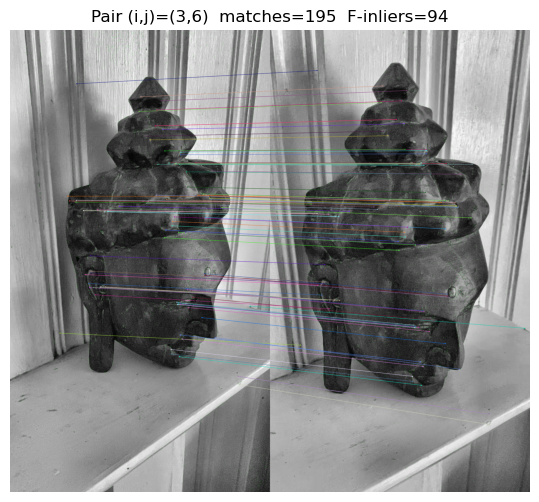

recover_pose_numpy: cheirality_inliers = 66 / 94  (det(R)=1.000)

=== Pair (i,j)=(3,6) ===
F =
 [[ 2.27191592e-08  1.03533825e-06 -4.91321812e-04]
 [-1.23078638e-06  7.06555685e-08  3.37988591e-03]
 [ 4.67696053e-04 -3.67905573e-03  2.26827149e-01]]
E =
 [[ 0.00899914  0.49373913  0.14549367]
 [-0.59717775  0.03579039  0.78752477]
 [-0.19488696 -0.84771368 -0.01659527]]
[pair 3-7] matches=173  F-inliers=75


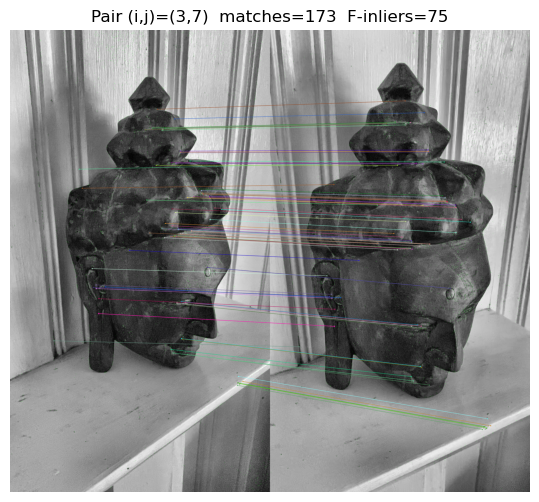

recover_pose_numpy: cheirality_inliers = 12 / 75  (det(R)=1.000)

=== Pair (i,j)=(3,7) ===
F =
 [[-3.46085102e-08 -7.85135185e-07  3.50661651e-04]
 [ 1.05923852e-06 -5.54756878e-08 -3.60248924e-03]
 [-2.50906950e-04  3.88157629e-03 -2.91820864e-01]]
E =
 [[-0.01216041 -0.3619684  -0.11969114]
 [ 0.50190201 -0.03731627 -0.85590919]
 [ 0.1955653   0.91091897  0.02464145]]
[pair 3-8] matches=118  F-inliers=25
[pair 3-9] matches=77  F-inliers=13
[pair 4-5] matches=262  F-inliers=118


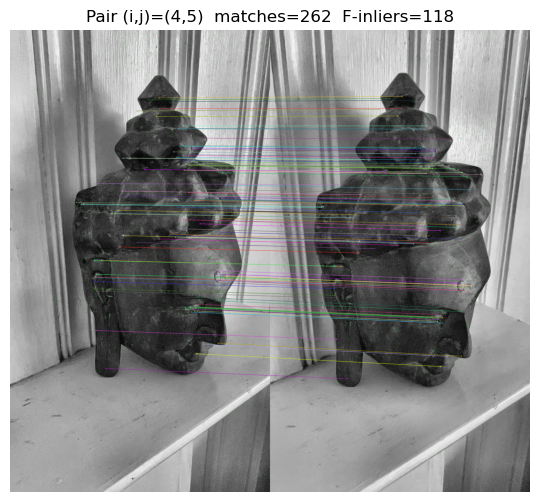

recover_pose_numpy: cheirality_inliers = 25 / 118  (det(R)=1.000)

=== Pair (i,j)=(4,5) ===
F =
 [[-3.56554899e-08 -1.32735094e-06  1.53618868e-03]
 [ 1.24681539e-06  1.72700906e-08  2.34324007e-03]
 [-1.53890676e-03 -2.57958197e-03  1.98880122e-01]]
E =
 [[-0.00753839 -0.56936814  0.07168464]
 [ 0.57361916 -0.00945658  0.81583392]
 [-0.0841064  -0.81782394 -0.00108029]]
[pair 4-6] matches=200  F-inliers=76


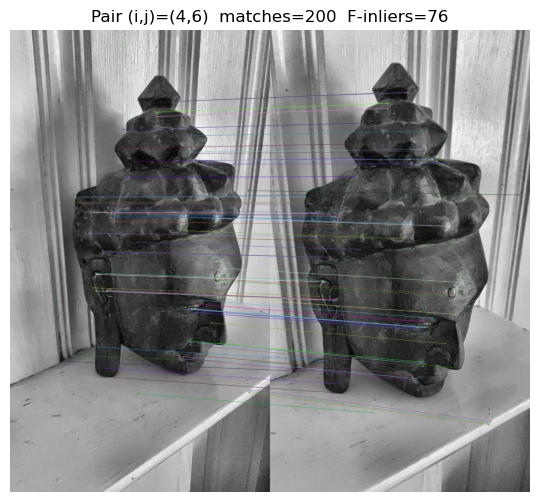

recover_pose_numpy: cheirality_inliers = 35 / 76  (det(R)=1.000)

=== Pair (i,j)=(4,6) ===
F =
 [[ 3.78710402e-08  1.23391669e-06 -8.42852876e-04]
 [-1.35148904e-06  4.26517648e-08  3.12237320e-03]
 [ 8.06314363e-04 -3.24374051e-03  1.05370500e-01]]
E =
 [[ 0.01856282  0.63462158  0.10951614]
 [-0.68523403  0.02537215  0.71989758]
 [-0.13831896 -0.75976487 -0.01001645]]
[pair 4-7] matches=151  F-inliers=43
[pair 4-8] matches=113  F-inliers=42
[pair 4-9] matches=74  F-inliers=12
[pair 5-6] matches=308  F-inliers=164


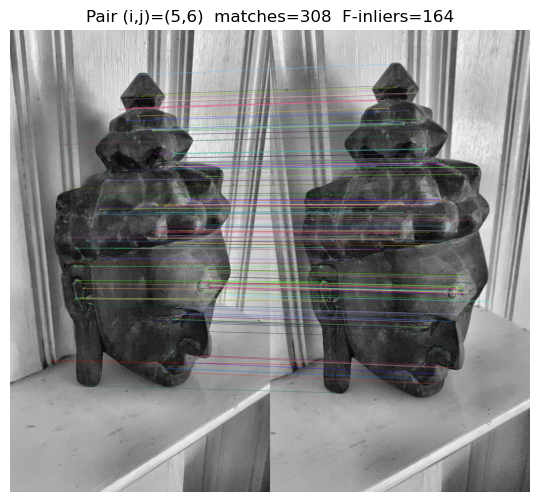

recover_pose_numpy: cheirality_inliers = 63 / 164  (det(R)=1.000)

=== Pair (i,j)=(5,6) ===
F =
 [[-1.12876942e-08 -7.38573316e-07  3.87107276e-04]
 [ 8.27211500e-07 -1.84967406e-08 -3.48862808e-03]
 [-3.54275043e-04  3.64079741e-03 -1.75273106e-01]]
E =
 [[-0.00393025 -0.3633696  -0.09754852]
 [ 0.41832245 -0.01291573 -0.90286594]
 [ 0.12331034  0.92351477  0.00436118]]
[pair 5-7] matches=220  F-inliers=96


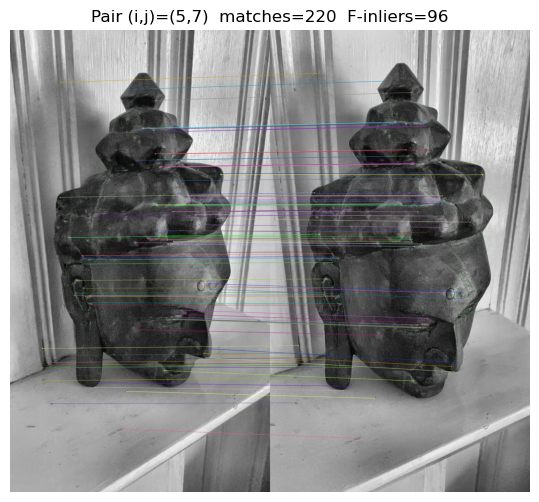

recover_pose_numpy: cheirality_inliers = 72 / 96  (det(R)=1.000)

=== Pair (i,j)=(5,7) ===
F =
 [[-4.09339534e-08 -6.61539075e-07  6.65044881e-04]
 [ 8.70200290e-07 -4.28505695e-08 -3.05202162e-03]
 [-6.61569543e-04  3.14167307e-03 -1.23097898e-01]]
E =
 [[ 0.02349587  0.38171082 -0.00242853]
 [-0.49446866  0.02482039  0.86882881]
 [-0.0508176  -0.92258147 -0.00459169]]
[pair 5-8] matches=153  F-inliers=54
[pair 5-9] matches=122  F-inliers=16
[pair 5-10] matches=83  F-inliers=8
[pair 5-11] matches=71  F-inliers=10
[pair 6-7] matches=398  F-inliers=243


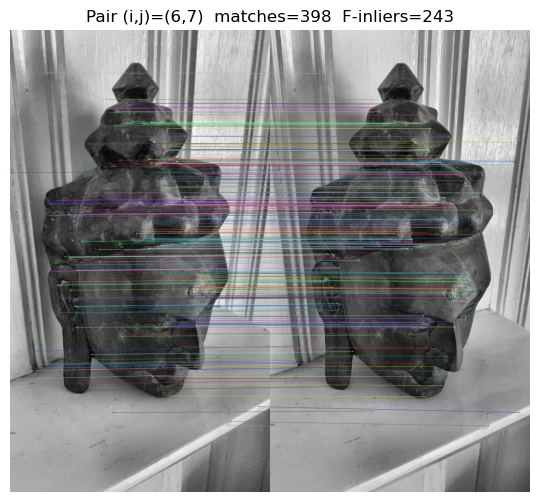

recover_pose_numpy: cheirality_inliers = 27 / 243  (det(R)=1.000)

=== Pair (i,j)=(6,7) ===
F =
 [[ 3.17524857e-09  3.24862861e-08 -9.54618735e-05]
 [ 6.75594972e-08  1.17570972e-08 -2.92550360e-03]
 [ 8.54424283e-05  2.84050822e-03  1.95410243e-02]]
E =
 [[-0.00188368 -0.01928235  0.0216175 ]
 [-0.03996532 -0.00185627  0.99896335]
 [-0.05268894 -0.99841552 -0.00438193]]
[pair 6-8] matches=271  F-inliers=108


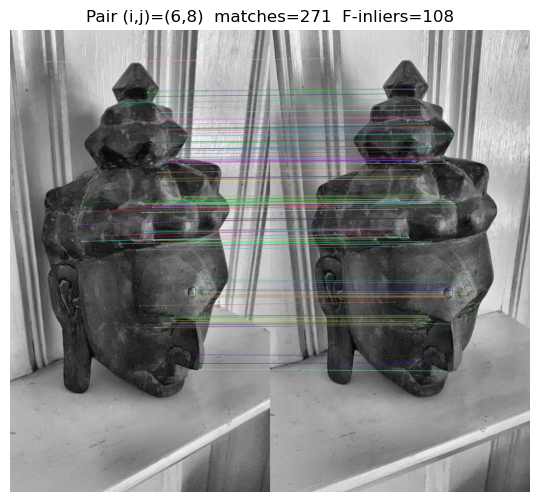

recover_pose_numpy: cheirality_inliers = 69 / 108  (det(R)=1.000)

=== Pair (i,j)=(6,8) ===
F =
 [[-1.42121146e-08 -2.46436333e-08  1.98956220e-04]
 [ 2.97007476e-07 -4.00416399e-09 -3.78717408e-03]
 [-2.00455364e-04  3.64344310e-03 -4.39988477e-02]]
E =
 [[ 0.00663468  0.01144041 -0.04561793]
 [-0.13875125  0.00658319  0.98923533]
 [-0.02056433 -0.99971448  0.00322263]]
[pair 6-9] matches=149  F-inliers=70


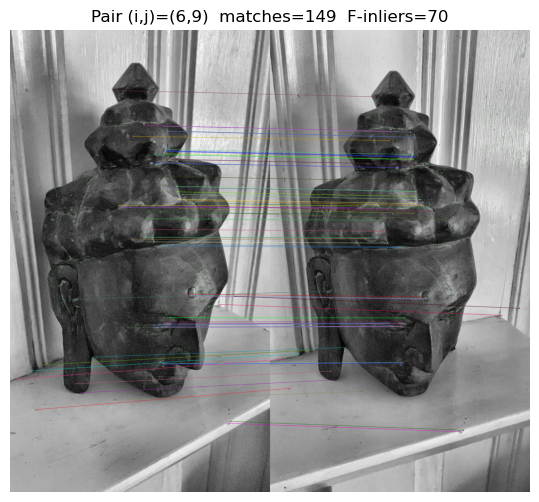

recover_pose_numpy: cheirality_inliers = 28 / 70  (det(R)=1.000)

=== Pair (i,j)=(6,9) ===
F =
 [[ 3.86487824e-08  5.55118547e-07 -4.22336457e-04]
 [-2.28869111e-07  4.37013698e-08 -2.71730799e-03]
 [ 3.35682899e-04  2.38612919e-03  1.46983147e-01]]
E =
 [[ 0.02313369  0.32918881  0.04694812]
 [-0.13885153  0.02457483 -0.98902661]
 [ 0.04749057  0.94264449  0.00203095]]
[pair 6-10] matches=118  F-inliers=28
[pair 6-11] matches=71  F-inliers=15
[pair 6-13] matches=73  F-inliers=9
[pair 7-8] matches=388  F-inliers=195


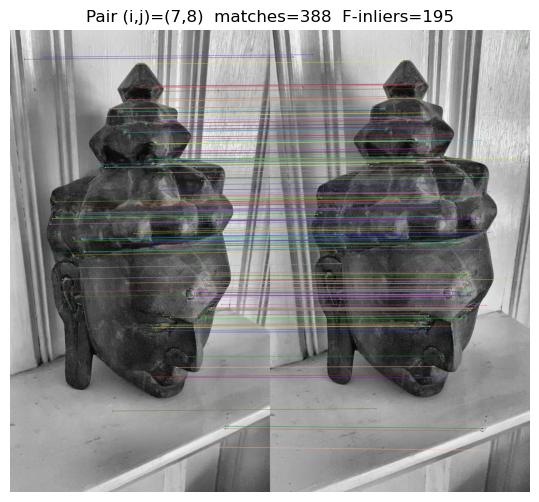

recover_pose_numpy: cheirality_inliers = 195 / 195  (det(R)=1.000)

=== Pair (i,j)=(7,8) ===
F =
 [[-1.27531912e-08 -1.78599055e-08  3.78600440e-04]
 [ 1.19310504e-07  8.48946170e-09 -3.03575501e-03]
 [-3.75553767e-04  2.97913675e-03 -3.79909639e-02]]
E =
 [[ 0.00734645  0.00986576 -0.11849519]
 [-0.06871891 -0.00166868  0.99054297]
 [ 0.08982742 -0.99590492  0.00339885]]
[pair 7-9] matches=202  F-inliers=97


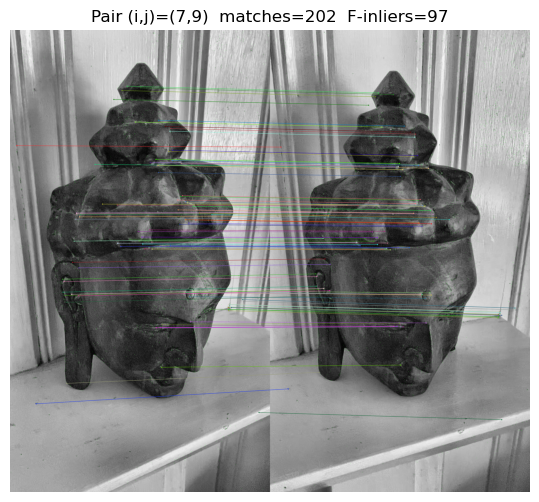

recover_pose_numpy: cheirality_inliers = 28 / 97  (det(R)=1.000)

=== Pair (i,j)=(7,9) ===
F =
 [[-2.55289996e-09  2.08135162e-07  2.36664681e-05]
 [ 1.04108405e-08  2.11983403e-10 -3.11377333e-03]
 [-3.48157810e-05  2.89604364e-03  1.18226464e-01]]
E =
 [[ 0.00142675 -0.11745861 -0.07062509]
 [-0.00568315 -0.00582939  0.99748311]
 [ 0.00861521 -0.99302265  0.00254854]]
[pair 7-10] matches=142  F-inliers=44
[pair 7-11] matches=112  F-inliers=23
[pair 7-12] matches=90  F-inliers=9
[pair 7-13] matches=89  F-inliers=14
[pair 8-9] matches=284  F-inliers=109


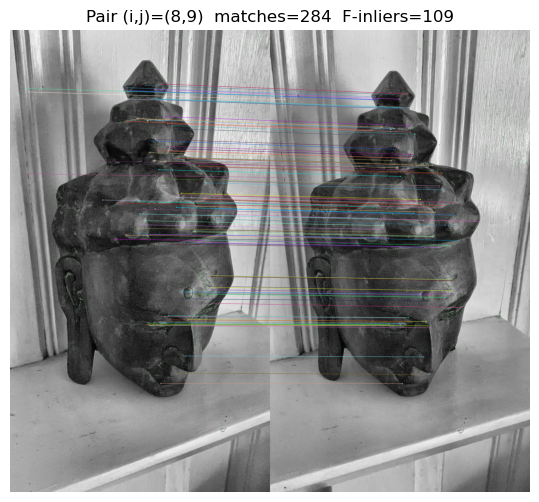

recover_pose_numpy: cheirality_inliers = 48 / 109  (det(R)=1.000)

=== Pair (i,j)=(8,9) ===
F =
 [[ 3.56714338e-08  1.83883559e-06 -1.40254195e-03]
 [-1.74276652e-06  3.82159385e-08 -2.16007754e-03]
 [ 1.38672228e-03  2.05879300e-03  7.57389471e-02]]
E =
 [[ 0.01234201  0.71235176  0.08473515]
 [-0.69636614  0.02065808 -0.71314048]
 [-0.06406475  0.69797802  0.00480459]]
[pair 8-10] matches=189  F-inliers=67
[pair 8-11] matches=127  F-inliers=29
[pair 8-12] matches=102  F-inliers=16
[pair 8-13] matches=111  F-inliers=15
[pair 9-10] matches=355  F-inliers=223


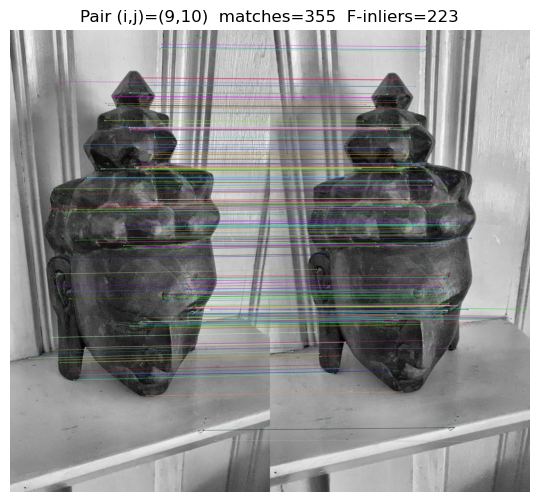

recover_pose_numpy: cheirality_inliers = 223 / 223  (det(R)=1.000)

=== Pair (i,j)=(9,10) ===
F =
 [[-4.16219961e-09  4.65012751e-07 -1.07495734e-05]
 [-3.60486580e-07  1.63702011e-08 -2.67946617e-03]
 [-8.47321321e-06  2.54834783e-03  4.76795978e-02]]
E =
 [[-0.00252743  0.27052868  0.14646875]
 [-0.2093003   0.01012642 -0.96692673]
 [-0.12112645  0.95488531 -0.00455104]]
[pair 9-11] matches=254  F-inliers=107


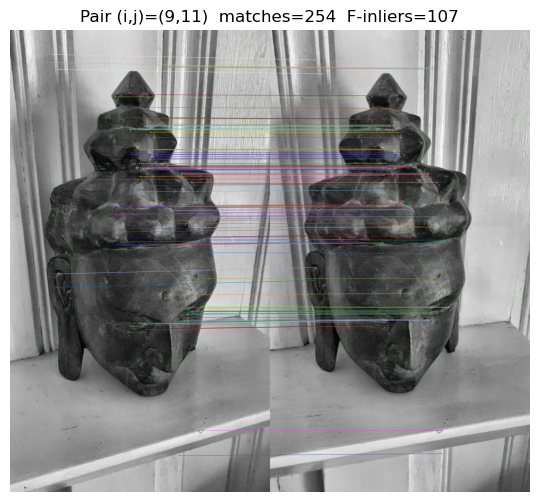

recover_pose_numpy: cheirality_inliers = 18 / 107  (det(R)=1.000)

=== Pair (i,j)=(9,11) ===
F =
 [[ 2.44743142e-08  7.59677839e-08 -3.10592772e-04]
 [-3.87038983e-07  1.39462639e-08  3.52343391e-03]
 [ 4.24763550e-04 -3.30174241e-03 -1.12597452e-01]]
E =
 [[ 0.01232606  0.04026787 -0.06609738]
 [-0.19519967  0.00480628  0.97845421]
 [ 0.01995171 -0.99896129  0.00610969]]
[pair 9-12] matches=164  F-inliers=72


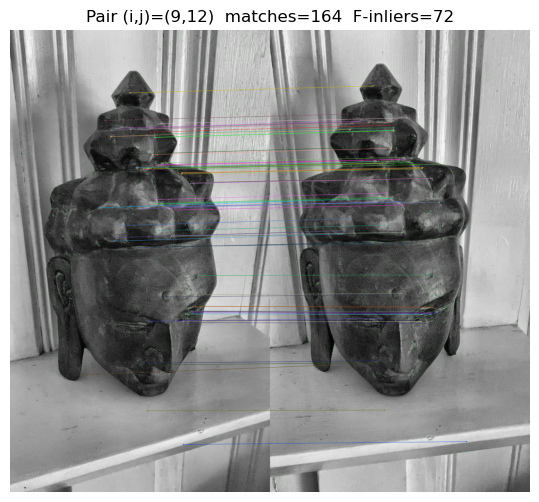

recover_pose_numpy: cheirality_inliers = 21 / 72  (det(R)=1.000)

=== Pair (i,j)=(9,12) ===
F =
 [[-6.73520725e-08 -8.77220754e-07  1.01577573e-03]
 [ 1.19796629e-06 -1.66967624e-09 -3.90294507e-03]
 [-1.03291831e-03  3.71475544e-03 -5.37868330e-03]]
E =
 [[-0.02665194 -0.4206614   0.0294191 ]
 [ 0.53295071 -0.01873911 -0.84523862]
 [ 0.01381315  0.90687837  0.00574824]]
[pair 9-13] matches=139  F-inliers=50
[pair 9-14] matches=103  F-inliers=17
[pair 9-15] matches=70  F-inliers=10
[pair 10-11] matches=348  F-inliers=174


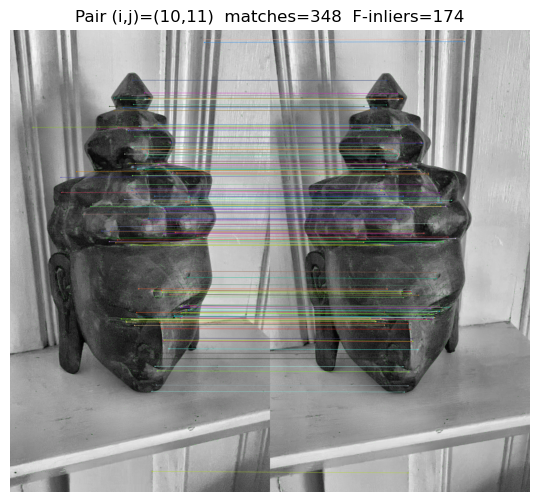

recover_pose_numpy: cheirality_inliers = 6 / 174  (det(R)=1.000)

=== Pair (i,j)=(10,11) ===
F =
 [[ 1.39003308e-08  2.68074684e-07 -4.73292834e-04]
 [-1.59289862e-07  1.94702894e-08 -3.05950412e-03]
 [ 4.33050198e-04  2.97235321e-03  1.60581435e-02]]
E =
 [[ 0.00747517  0.14406648 -0.06523109]
 [-0.08752811  0.0035649  -0.99399827]
 [ 0.09100452  0.98535294  0.00502133]]
[pair 10-12] matches=251  F-inliers=142


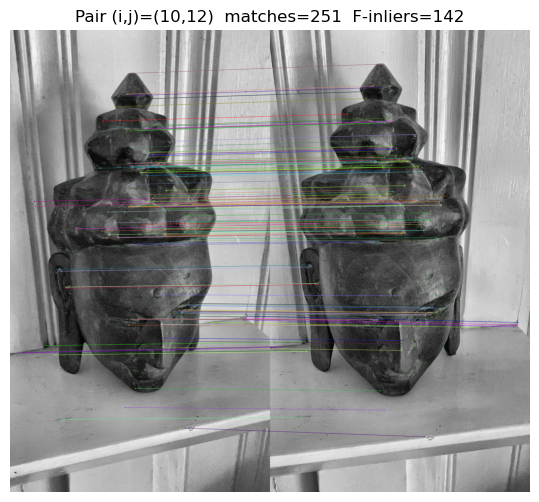

recover_pose_numpy: cheirality_inliers = 114 / 142  (det(R)=1.000)

=== Pair (i,j)=(10,12) ===
F =
 [[-1.44764694e-08 -2.07834668e-07  3.03311123e-04]
 [ 4.24363795e-07 -1.17742983e-08 -3.26933390e-03]
 [-3.80328691e-04  3.28481313e-03 -8.54715734e-02]]
E =
 [[ 0.00788829  0.11206368 -0.03050721]
 [-0.23196877  0.00699687  0.97220666]
 [-0.00591013 -0.99366238  0.00217234]]
[pair 10-13] matches=247  F-inliers=113


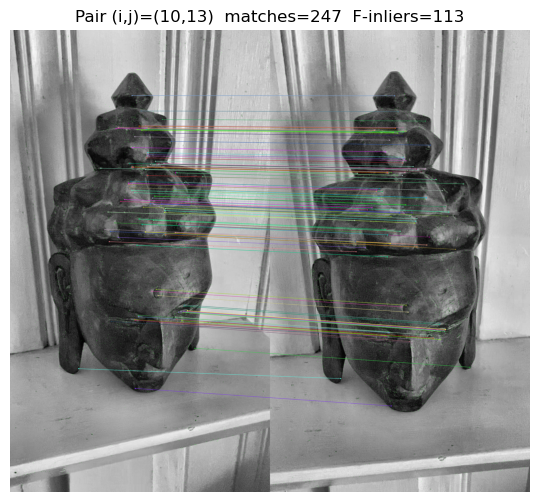

recover_pose_numpy: cheirality_inliers = 0 / 113  (det(R)=1.000)

=== Pair (i,j)=(10,13) ===
F =
 [[ 2.70791199e-09 -7.48765720e-07  3.11885657e-04]
 [ 1.10715676e-06 -7.62224779e-08 -4.14134051e-03]
 [-4.91333447e-04  4.30347417e-03  1.17706133e-03]]
E =
 [[-4.21750720e-04 -3.14073103e-01 -9.61944800e-02]
 [ 4.63864585e-01 -2.26436708e-02 -8.80291159e-01]
 [ 1.44606199e-01  9.38238769e-01  1.74921650e-02]]
[pair 10-14] matches=133  F-inliers=31
[pair 10-15] matches=82  F-inliers=14
[pair 10-16] matches=74  F-inliers=10
[pair 11-12] matches=342  F-inliers=202


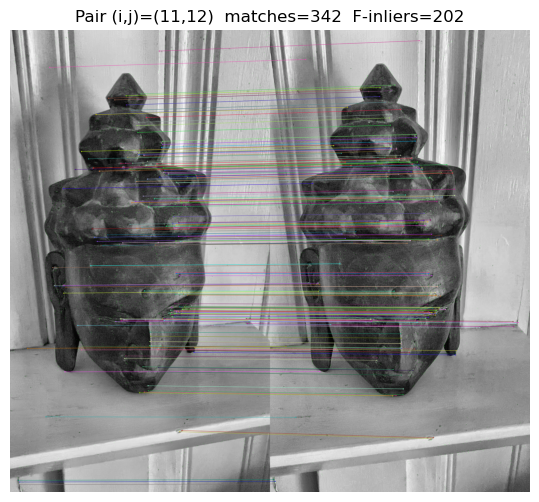

recover_pose_numpy: cheirality_inliers = 202 / 202  (det(R)=1.000)

=== Pair (i,j)=(11,12) ===
F =
 [[ 8.41777495e-09  6.71175906e-07 -5.86344185e-04]
 [-7.69588516e-07  1.44446432e-08  3.08402659e-03]
 [ 6.19642292e-04 -3.14706800e-03  9.78109659e-02]]
E =
 [[ 0.0044227   0.38356983  0.02161565]
 [-0.44144386  0.01036568  0.89692923]
 [-0.03734229 -0.92278163  0.00220159]]
[pair 11-13] matches=361  F-inliers=188


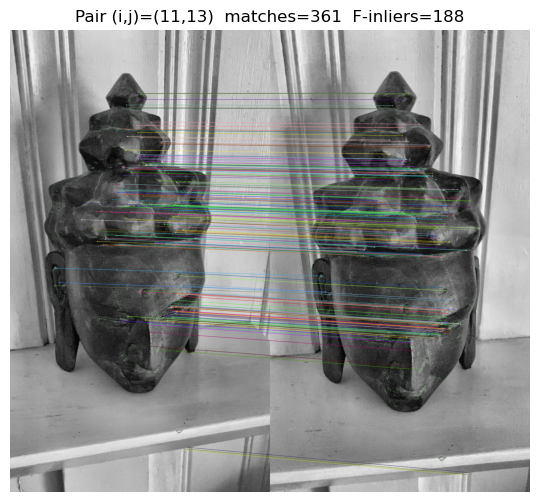

recover_pose_numpy: cheirality_inliers = 53 / 188  (det(R)=1.000)

=== Pair (i,j)=(11,13) ===
F =
 [[ 3.25312855e-08  4.86582860e-08 -1.04487108e-03]
 [ 5.46482141e-08  3.15149830e-09 -3.25360107e-03]
 [ 1.07500065e-03  3.41598448e-03 -5.53389195e-02]]
E =
 [[ 0.01656429  0.02475894 -0.2912094 ]
 [ 0.02972952  0.00731305 -0.95597501]
 [ 0.31534991  0.94840013  0.02399574]]
[pair 11-14] matches=202  F-inliers=79


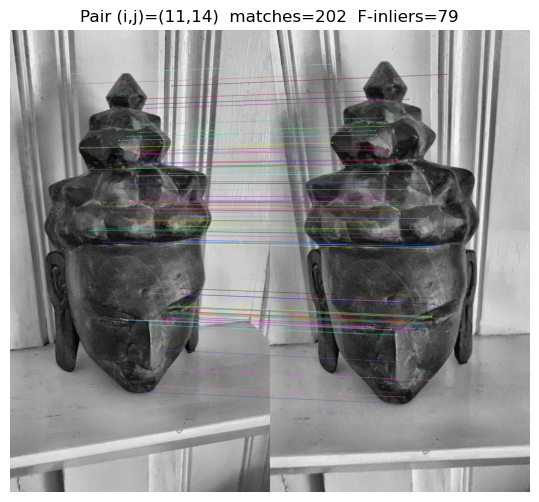

recover_pose_numpy: cheirality_inliers = 0 / 79  (det(R)=1.000)

=== Pair (i,j)=(11,14) ===
F =
 [[ 1.80635928e-08 -6.17891916e-07  7.41439779e-05]
 [ 9.18394537e-07 -5.55883864e-08 -3.48946504e-03]
 [-1.81263941e-04  3.62429959e-03 -1.47699177e-01]]
E =
 [[ 0.0098576  -0.30630576 -0.1488689 ]
 [ 0.45214293 -0.03524305 -0.87763366]
 [ 0.2007834   0.93141488  0.0124037 ]]
[pair 11-15] matches=114  F-inliers=37
[pair 11-16] matches=101  F-inliers=10
[pair 11-17] matches=71  F-inliers=14
[pair 12-13] matches=421  F-inliers=237


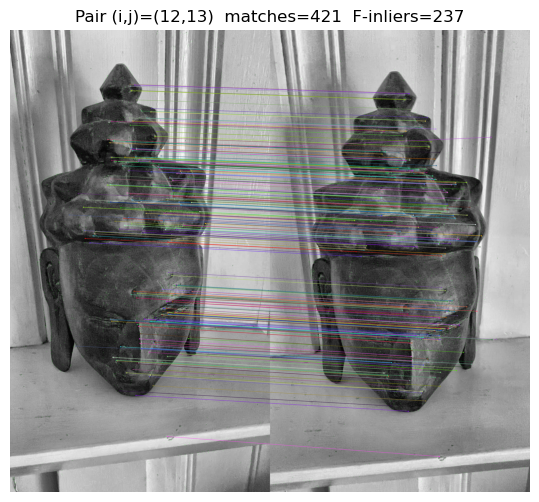

recover_pose_numpy: cheirality_inliers = 128 / 237  (det(R)=1.000)

=== Pair (i,j)=(12,13) ===
F =
 [[-8.91493121e-08  2.38883791e-06  5.34766192e-04]
 [-2.45615260e-06  2.61847350e-08  2.80347597e-03]
 [-3.38469963e-04 -2.95978818e-03 -1.51038073e-01]]
E =
 [[ 0.02129324 -0.78463031 -0.52939083]
 [ 0.80293346 -0.00295524 -0.28251096]
 [ 0.52613464  0.31861523  0.02811737]]
[pair 12-14] matches=277  F-inliers=119


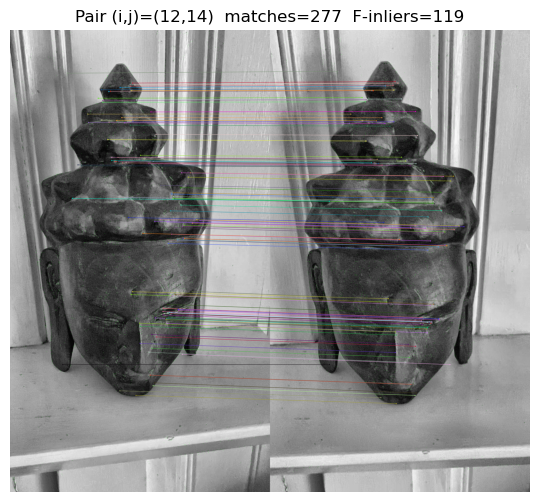

recover_pose_numpy: cheirality_inliers = 38 / 119  (det(R)=1.000)

=== Pair (i,j)=(12,14) ===
F =
 [[-4.75486827e-08  1.80710885e-07  5.08852368e-04]
 [-3.96307680e-07  3.07428477e-08  2.83560917e-03]
 [-3.82212781e-04 -2.85689578e-03 -1.50729905e-02]]
E =
 [[ 0.02911979 -0.1100048  -0.233648  ]
 [ 0.23968048 -0.02441212 -0.94098869]
 [ 0.27454962  0.95563275  0.01859463]]
[pair 12-15] matches=165  F-inliers=80


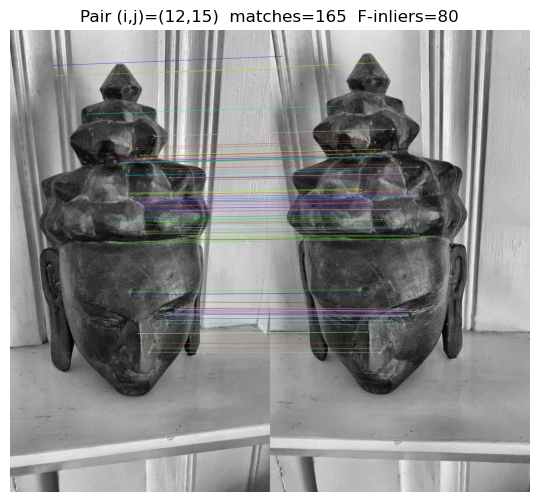

recover_pose_numpy: cheirality_inliers = 13 / 80  (det(R)=1.000)

=== Pair (i,j)=(12,15) ===
F =
 [[-2.51326383e-09  5.64010965e-07 -2.11792044e-04]
 [-1.00309950e-06  1.26635328e-07  4.02497296e-03]
 [ 3.63683182e-04 -4.04379463e-03  1.14322412e-01]]
E =
 [[-0.00105416 -0.2551269  -0.08205709]
 [ 0.42834253 -0.05472275 -0.89741045]
 [ 0.15761681  0.95469605 -0.00841267]]
[pair 12-16] matches=107  F-inliers=41
[pair 12-17] matches=92  F-inliers=18
[pair 12-18] matches=80  F-inliers=14
[pair 13-14] matches=334  F-inliers=165


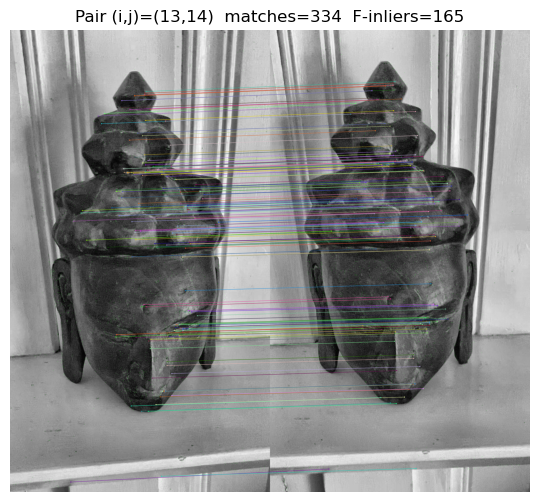

recover_pose_numpy: cheirality_inliers = 0 / 165  (det(R)=1.000)

=== Pair (i,j)=(13,14) ===
F =
 [[-7.57235888e-09  1.06078009e-07  1.68354270e-04]
 [-2.16657966e-07  1.20132261e-08  3.09847761e-03]
 [-1.31079229e-04 -3.07291754e-03  1.23699645e-01]]
E =
 [[ 0.00425983 -0.06119915 -0.08860685]
 [ 0.1213875  -0.01905865 -0.98835276]
 [ 0.11177142  0.99188518 -0.01081464]]
[pair 13-15] matches=165  F-inliers=65
[pair 13-16] matches=102  F-inliers=34
[pair 13-17] matches=93  F-inliers=20
[pair 13-18] matches=81  F-inliers=11
[pair 13-19] matches=90  F-inliers=11
[pair 13-20] matches=72  F-inliers=10
[pair 13-21] matches=88  F-inliers=11
[pair 14-15] matches=270  F-inliers=146


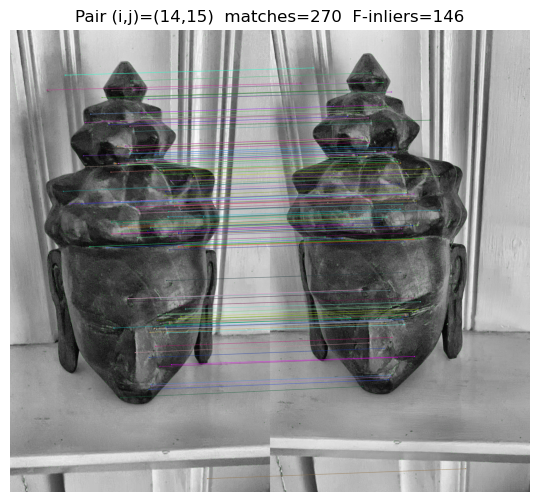

recover_pose_numpy: cheirality_inliers = 75 / 146  (det(R)=1.000)

=== Pair (i,j)=(14,15) ===
F =
 [[-1.85689611e-08 -4.62894783e-07  5.94989106e-04]
 [ 5.64671845e-07 -2.38916246e-08 -3.49096521e-03]
 [-5.56258632e-04  3.41456659e-03 -7.28207627e-02]]
E =
 [[-0.00898068 -0.24479973  0.0405504 ]
 [ 0.28884543 -0.01872318 -0.95643869]
 [-0.00925965  0.9693093  -0.0120267 ]]
[pair 14-16] matches=174  F-inliers=63
[pair 14-17] matches=137  F-inliers=60
[pair 14-18] matches=126  F-inliers=34
[pair 14-19] matches=89  F-inliers=17
[pair 14-21] matches=76  F-inliers=11
[pair 15-16] matches=409  F-inliers=204


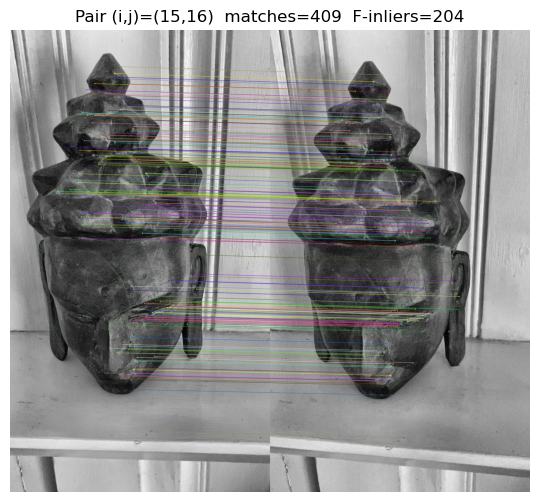

recover_pose_numpy: cheirality_inliers = 57 / 204  (det(R)=1.000)

=== Pair (i,j)=(15,16) ===
F =
 [[-6.20942618e-09  1.79249798e-07  1.86663112e-04]
 [-2.61714392e-07  7.99801721e-09  3.03647436e-03]
 [-1.54837785e-04 -2.98022508e-03 -1.14263458e-01]]
E =
 [[-0.00341925  0.1045673   0.11952804]
 [-0.15259727 -0.00113938  0.98107515]
 [-0.14103381 -0.98436491 -0.01032212]]
[pair 15-17] matches=306  F-inliers=134


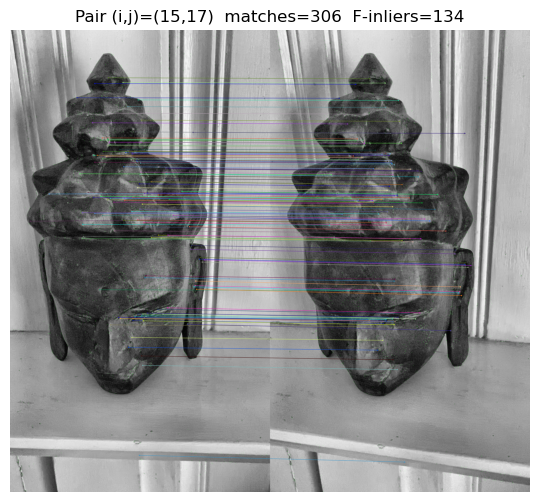

recover_pose_numpy: cheirality_inliers = 34 / 134  (det(R)=1.000)

=== Pair (i,j)=(15,17) ===
F =
 [[ 3.13990413e-08  4.21439276e-07 -5.82508513e-04]
 [-1.81825783e-07  2.19571753e-08 -3.48623539e-03]
 [ 4.99986972e-04  3.36572464e-03  4.26294685e-02]]
E =
 [[ 0.01445713  0.1952006  -0.04442857]
 [-0.087371    0.00785618 -0.9951095 ]
 [ 0.09273178  0.9762706   0.0084865 ]]
[pair 15-18] matches=260  F-inliers=135


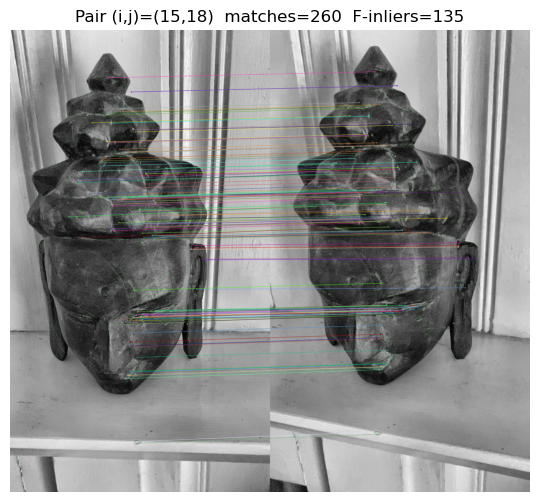

recover_pose_numpy: cheirality_inliers = 45 / 135  (det(R)=1.000)

=== Pair (i,j)=(15,18) ===
F =
 [[ 2.68184337e-08  1.69803130e-07 -3.23451487e-04]
 [-5.06581091e-07  4.35968707e-08  3.52862684e-03]
 [ 3.75381072e-04 -3.41751851e-03  7.29090478e-02]]
E =
 [[-0.013529   -0.08827678  0.0426621 ]
 [ 0.25457231 -0.02359388 -0.96581911]
 [ 0.02883017  0.99550975 -0.01276714]]
[pair 15-19] matches=170  F-inliers=59
[pair 15-20] matches=135  F-inliers=31
[pair 15-21] matches=132  F-inliers=38
[pair 15-22] matches=95  F-inliers=16
[pair 15-24] matches=74  F-inliers=8
[pair 16-17] matches=404  F-inliers=208


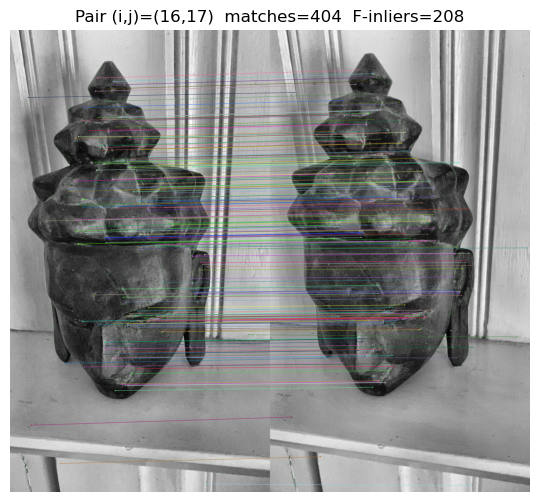

recover_pose_numpy: cheirality_inliers = 25 / 208  (det(R)=1.000)

=== Pair (i,j)=(16,17) ===
F =
 [[ 3.07883328e-08  5.93514616e-07 -9.73560929e-04]
 [-7.19406569e-07  3.87236783e-08  3.09040063e-03]
 [ 9.93931996e-04 -3.14496141e-03  1.00218364e-01]]
E =
 [[ 0.01783261  0.34197646 -0.13022632]
 [-0.40672186  0.01532439  0.90430734]
 [ 0.1042645  -0.9334249   0.01388511]]
[pair 16-18] matches=349  F-inliers=163


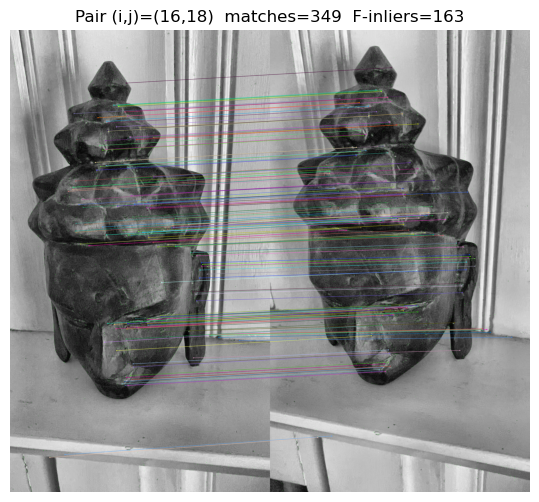

recover_pose_numpy: cheirality_inliers = 133 / 163  (det(R)=1.000)

=== Pair (i,j)=(16,18) ===
F =
 [[ 2.58928452e-08 -4.60270804e-08 -4.72901319e-04]
 [-1.21205784e-07  4.16424351e-08  2.92334695e-03]
 [ 4.61720564e-04 -2.93787619e-03  2.11363618e-01]]
E =
 [[ 0.01497992 -0.02616907 -0.17048032]
 [-0.07005476  0.02064552  0.98244376]
 [ 0.1216829  -0.99175248  0.03343459]]
[pair 16-19] matches=240  F-inliers=97


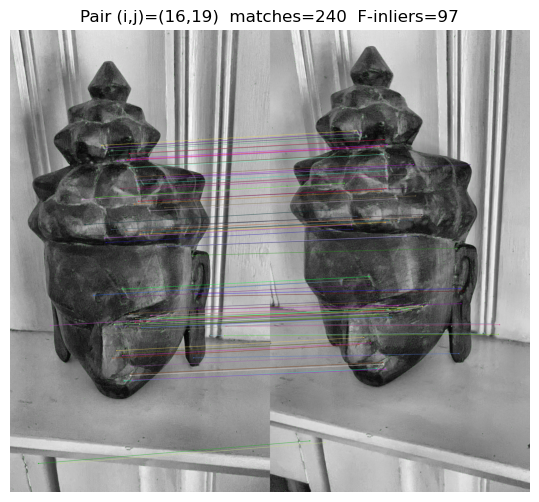

recover_pose_numpy: cheirality_inliers = 0 / 97  (det(R)=1.000)

=== Pair (i,j)=(16,19) ===
F =
 [[ 1.55758583e-08 -2.65498396e-07 -6.48578405e-05]
 [-3.47513264e-08  8.39611523e-08  3.04674679e-03]
 [ 1.72529926e-04 -3.10181045e-03  2.00334016e-01]]
E =
 [[ 0.00826073 -0.14049564 -0.09710032]
 [-0.0181994   0.02757519  0.99422865]
 [ 0.0457908  -0.98858111  0.04233951]]
[pair 16-20] matches=205  F-inliers=53
[pair 16-21] matches=149  F-inliers=53
[pair 16-22] matches=131  F-inliers=48
[pair 16-23] matches=93  F-inliers=24
[pair 16-24] matches=84  F-inliers=16
[pair 17-18] matches=466  F-inliers=256


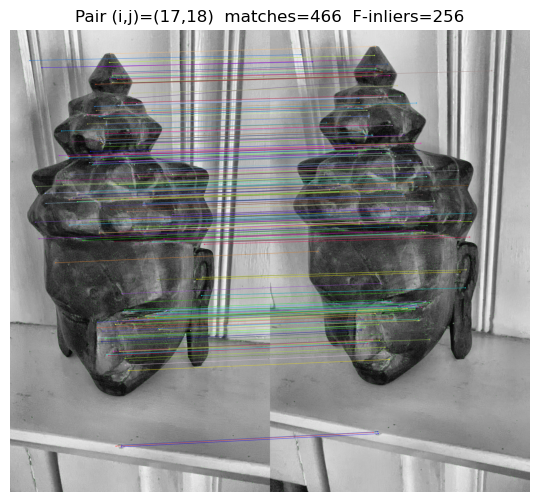

recover_pose_numpy: cheirality_inliers = 119 / 256  (det(R)=1.000)

=== Pair (i,j)=(17,18) ===
F =
 [[ 2.63959507e-08  5.54327967e-07 -8.29717787e-04]
 [-6.82137520e-07  2.43705127e-08  3.28922758e-03]
 [ 8.20072161e-04 -3.23810666e-03  1.04918789e-01]]
E =
 [[ 0.01295129  0.30892168 -0.08758627]
 [-0.36841082  0.01977351  0.92563089]
 [ 0.06047918 -0.94863086  0.01612446]]
[pair 17-19] matches=386  F-inliers=202


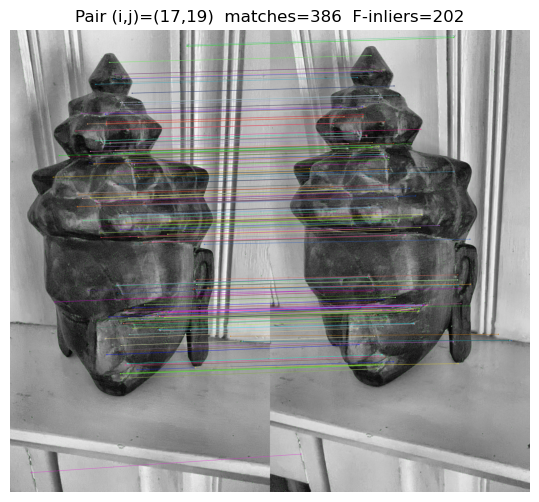

recover_pose_numpy: cheirality_inliers = 109 / 202  (det(R)=1.000)

=== Pair (i,j)=(17,19) ===
F =
 [[-5.77969411e-09  3.22325571e-08  7.18194831e-05]
 [ 1.63966487e-07 -1.35710389e-08 -2.88266026e-03]
 [-1.45802723e-04  2.79699251e-03 -4.95177574e-02]]
E =
 [[ 0.00352032 -0.01989002 -0.03537612]
 [-0.09963955  0.01261605  0.99429912]
 [-0.00258802 -0.99972177  0.0131251 ]]
[pair 17-20] matches=276  F-inliers=106


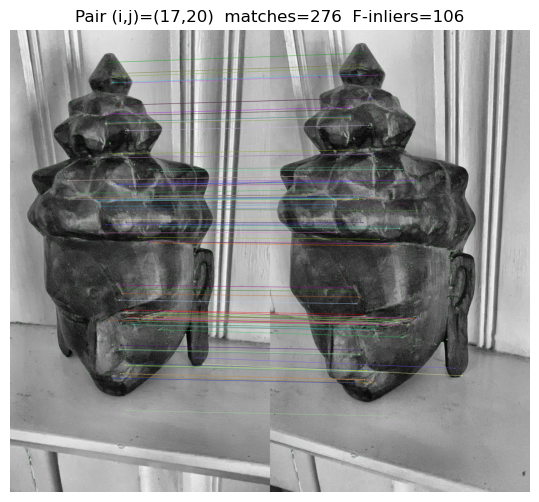

recover_pose_numpy: cheirality_inliers = 0 / 106  (det(R)=1.000)

=== Pair (i,j)=(17,20) ===
F =
 [[ 2.85186838e-08  4.48165506e-07 -5.37663834e-04]
 [-6.20598997e-07  6.74853896e-08  3.03827484e-03]
 [ 5.39227443e-04 -3.18182059e-03  1.14933992e-01]]
E =
 [[ 0.01799101  0.25880368 -0.03492291]
 [-0.35897724  0.02278147  0.93243675]
 [-0.01943145 -0.96552309  0.00655655]]
[pair 17-21] matches=225  F-inliers=132


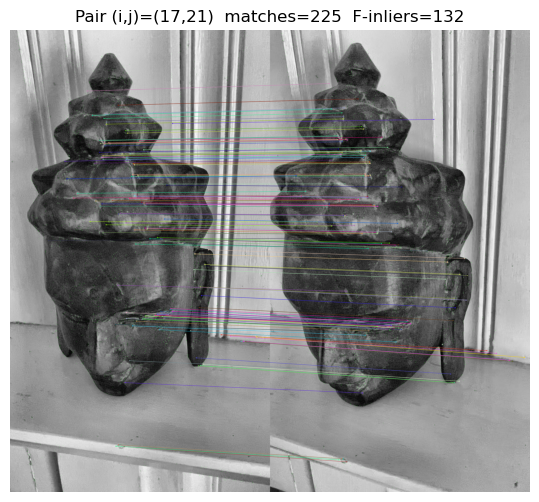

recover_pose_numpy: cheirality_inliers = 96 / 132  (det(R)=1.000)

=== Pair (i,j)=(17,21) ===
F =
 [[-7.02377605e-09 -4.15159540e-07  1.66808139e-04]
 [ 6.78667331e-07 -4.58350237e-08 -3.00419746e-03]
 [-2.01746932e-04  3.08406378e-03 -1.09532242e-01]]
E =
 [[ 0.00375048  0.24275953  0.08108601]
 [-0.39622929  0.03044906  0.91390624]
 [-0.15036207 -0.95843229 -0.01132103]]
[pair 17-22] matches=189  F-inliers=71


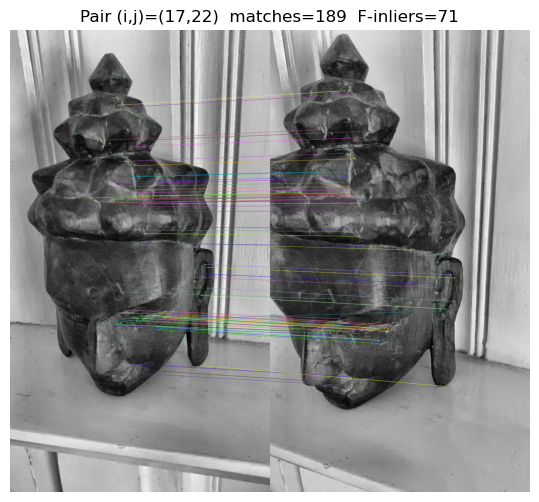

recover_pose_numpy: cheirality_inliers = 2 / 71  (det(R)=1.000)

=== Pair (i,j)=(17,22) ===
F =
 [[-2.73707018e-08 -5.94103225e-07  2.94244602e-04]
 [ 8.50858222e-07 -4.52866326e-08 -3.40243472e-03]
 [-2.04833705e-04  3.57604906e-03 -2.87120439e-01]]
E =
 [[-0.01123545 -0.29937179 -0.0906081 ]
 [ 0.43496025 -0.03683825 -0.89499504]
 [ 0.16918882  0.93898157  0.01286948]]
[pair 17-23] matches=121  F-inliers=46
[pair 17-24] matches=113  F-inliers=28
[pair 18-19] matches=511  F-inliers=292


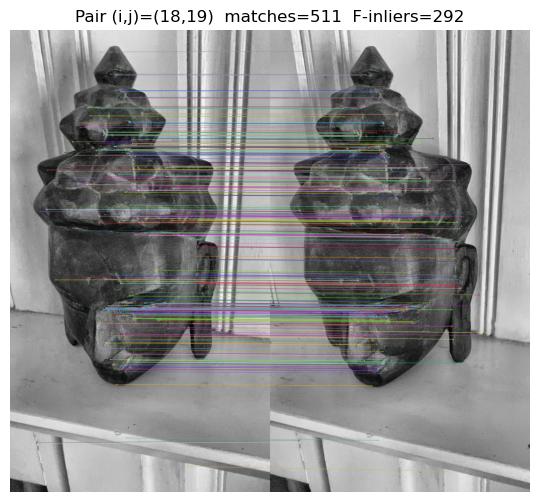

recover_pose_numpy: cheirality_inliers = 128 / 292  (det(R)=1.000)

=== Pair (i,j)=(18,19) ===
F =
 [[ 2.81227015e-08  4.80442839e-07 -1.06202802e-03]
 [-3.87508640e-07 -3.77413051e-09 -2.54315909e-03]
 [ 9.97148194e-04  2.53037666e-03  9.22198861e-05]]
E =
 [[ 0.0149662   0.27672085 -0.20170839]
 [-0.22994487 -0.00302635 -0.95243739]
 [ 0.21565029  0.9359369   0.00340704]]
[pair 18-20] matches=377  F-inliers=183


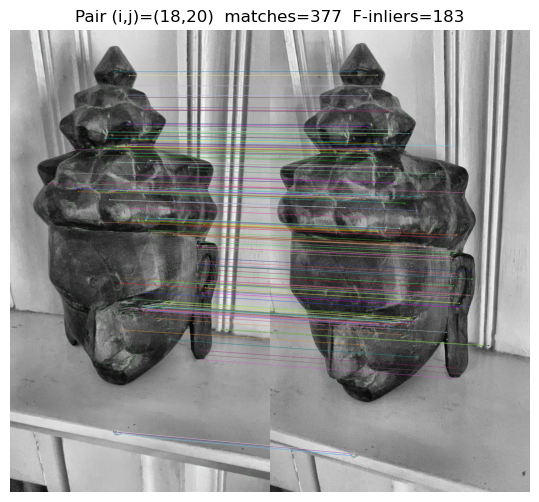

recover_pose_numpy: cheirality_inliers = 45 / 183  (det(R)=1.000)

=== Pair (i,j)=(18,20) ===
F =
 [[-1.23633909e-08  1.22522419e-06 -3.18318848e-04]
 [-1.43955420e-06  2.28530068e-08  3.60151212e-03]
 [ 4.21660678e-04 -3.61790774e-03 -2.53804282e-02]]
E =
 [[ 0.00434059 -0.56527624 -0.22733334]
 [ 0.63636552 -0.01870553 -0.73667892]
 [ 0.25072254  0.78576211  0.02174353]]
[pair 18-21] matches=342  F-inliers=172


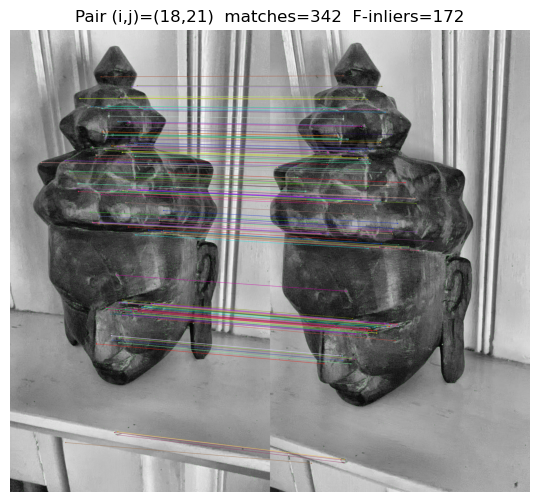

recover_pose_numpy: cheirality_inliers = 41 / 172  (det(R)=1.000)

=== Pair (i,j)=(18,21) ===
F =
 [[-2.13640009e-09  2.11425042e-07  4.56480391e-05]
 [-3.45096974e-07  2.16992859e-08  2.95394379e-03]
 [-5.45325048e-05 -3.12674276e-03  6.14445214e-02]]
E =
 [[-2.05634299e-03  1.18282710e-01  8.47120337e-02]
 [-2.08689166e-01 -1.47454637e-04  9.74381183e-01]
 [-1.30034997e-01 -9.84192162e-01 -1.77665609e-02]]
[pair 18-22] matches=271  F-inliers=135


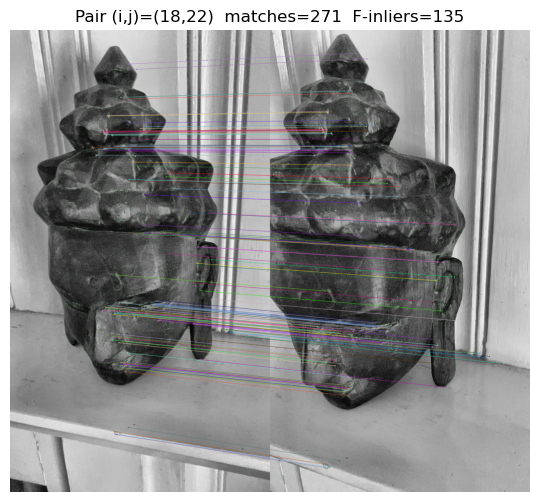

recover_pose_numpy: cheirality_inliers = 22 / 135  (det(R)=1.000)

=== Pair (i,j)=(18,22) ===
F =
 [[ 6.57350639e-09  5.66162919e-07 -1.55349216e-04]
 [-6.98885419e-07  5.01736302e-08  2.64895413e-03]
 [ 1.35268397e-04 -2.85087371e-03  1.41306864e-01]]
E =
 [[-0.00261752 -0.3550734  -0.14605158]
 [ 0.45466641 -0.02833741 -0.87774674]
 [ 0.19743672  0.91404266  0.01287763]]
[pair 18-23] matches=196  F-inliers=75


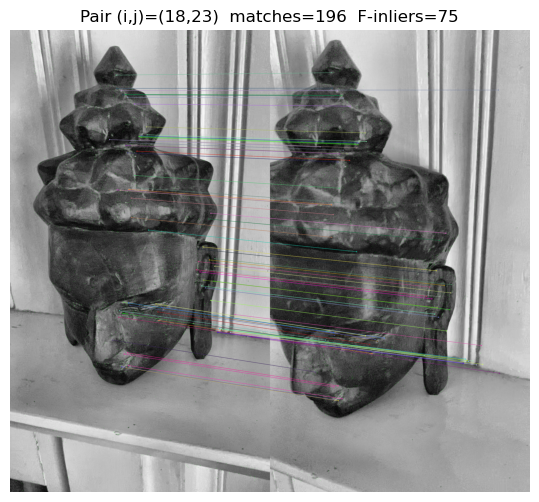

recover_pose_numpy: cheirality_inliers = 10 / 75  (det(R)=1.000)

=== Pair (i,j)=(18,23) ===
F =
 [[-1.43075576e-08 -1.05003155e-06  5.00915279e-04]
 [ 1.26236120e-06 -7.34456632e-08 -3.00538994e-03]
 [-5.93123800e-04  3.11742988e-03  4.24852559e-02]]
E =
 [[ 0.0145082   0.57452949  0.1569181 ]
 [-0.66368832  0.03129368  0.73146167]
 [-0.19698052 -0.79322161 -0.02413699]]
[pair 18-24] matches=176  F-inliers=55
[pair 19-20] matches=461  F-inliers=237


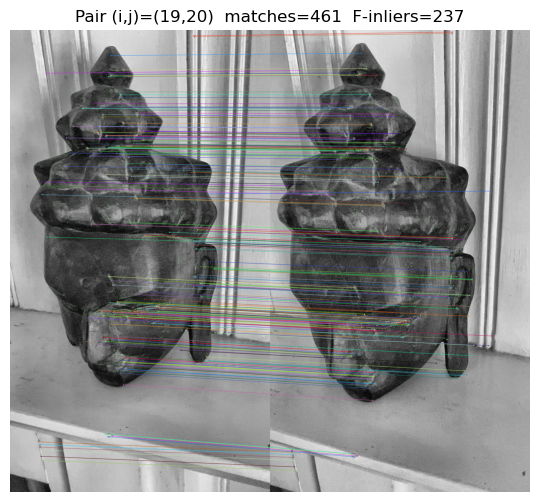

recover_pose_numpy: cheirality_inliers = 209 / 237  (det(R)=1.000)

=== Pair (i,j)=(19,20) ===
F =
 [[ 3.28178595e-09  1.01836309e-06 -5.39664218e-05]
 [-1.04889424e-06  1.76016105e-08  2.62453754e-03]
 [ 3.06156138e-05 -2.70995177e-03  4.51214464e-02]]
E =
 [[ 5.21232299e-04 -5.96687514e-01 -3.18835493e-01]
 [ 6.20115361e-01 -1.22624475e-02 -7.16007529e-01]
 [ 3.32769990e-01  7.30841512e-01  9.07063122e-03]]
[pair 19-21] matches=441  F-inliers=235


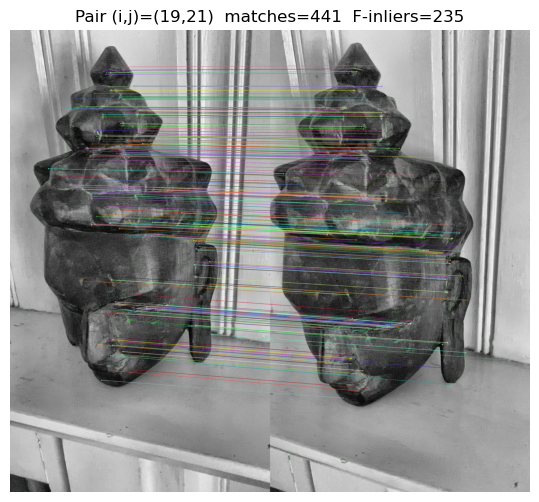

recover_pose_numpy: cheirality_inliers = 232 / 235  (det(R)=1.000)

=== Pair (i,j)=(19,21) ===
F =
 [[-2.66617272e-08 -1.59191348e-06  7.34093020e-04]
 [ 1.67677541e-06 -3.33545132e-08 -3.52852325e-03]
 [-7.27683115e-04  3.61713330e-03 -2.54139543e-03]]
E =
 [[ 0.01204952  0.68992791  0.20378518]
 [-0.72017309  0.0150986   0.66488828]
 [-0.21779302 -0.68827565 -0.01466443]]
[pair 19-22] matches=326  F-inliers=162


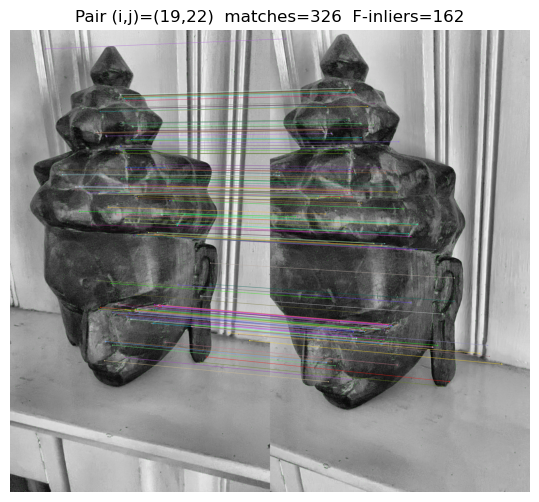

recover_pose_numpy: cheirality_inliers = 0 / 162  (det(R)=1.000)

=== Pair (i,j)=(19,22) ===
F =
 [[-2.60208833e-08 -1.32740838e-06  5.37603228e-04]
 [ 1.45089270e-06 -2.63403346e-08 -3.39572575e-03]
 [-4.86458070e-04  3.49591594e-03 -1.13321488e-01]]
E =
 [[-0.00824202 -0.62119267 -0.20891793]
 [ 0.66904128 -0.02340381 -0.71281273]
 [ 0.23526188  0.74739144  0.01403358]]
[pair 19-23] matches=251  F-inliers=111


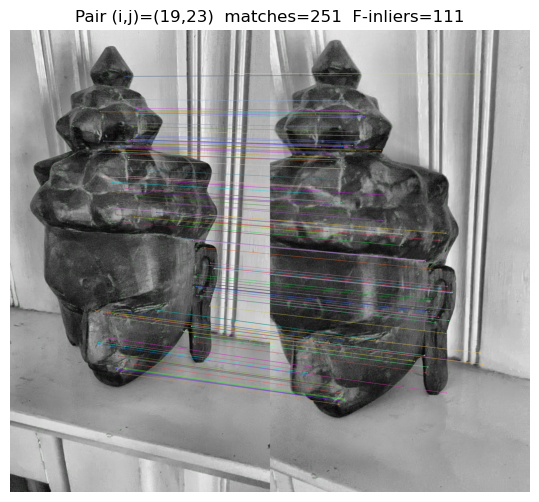

recover_pose_numpy: cheirality_inliers = 23 / 111  (det(R)=1.000)

=== Pair (i,j)=(19,23) ===
F =
 [[-3.54798657e-08 -1.62264262e-06  6.62847561e-04]
 [ 1.78242291e-06 -3.72385475e-08 -3.21160983e-03]
 [-6.74528488e-04  3.18614167e-03  4.51084195e-02]]
E =
 [[-0.01767668 -0.74717211 -0.24432052]
 [ 0.77676163 -0.02383008 -0.58296331]
 [ 0.26025135  0.60822495  0.01696362]]
[pair 19-24] matches=194  F-inliers=93


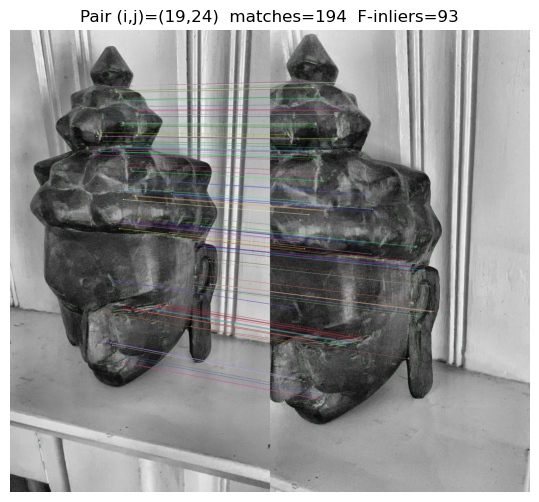

recover_pose_numpy: cheirality_inliers = 17 / 93  (det(R)=1.000)

=== Pair (i,j)=(19,24) ===
F =
 [[ 4.16969051e-08  1.48029390e-06 -6.37942417e-04]
 [-1.56333110e-06  2.16327475e-08  3.29978493e-03]
 [ 5.75162962e-04 -3.31162860e-03  1.28201356e-02]]
E =
 [[ 0.0170686   0.69325396  0.22216862]
 [-0.71585231  0.0183256   0.6637894 ]
 [-0.23903325 -0.67753126 -0.01290239]]
[pair 20-21] matches=506  F-inliers=317


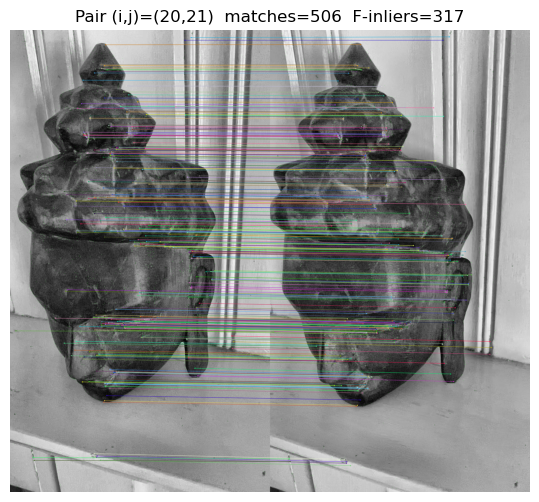

recover_pose_numpy: cheirality_inliers = 297 / 317  (det(R)=1.000)

=== Pair (i,j)=(20,21) ===
F =
 [[-3.69626311e-09 -9.10746675e-07  4.44883468e-04]
 [ 9.56988452e-07 -1.14603930e-08 -2.95945035e-03]
 [-4.59674607e-04  2.96856413e-03  1.13818735e-02]]
E =
 [[ 0.00300745  0.52868754  0.14468461]
 [-0.5504303   0.00586959  0.82235015]
 [-0.15460828 -0.83447654 -0.0049252 ]]
[pair 20-22] matches=394  F-inliers=214


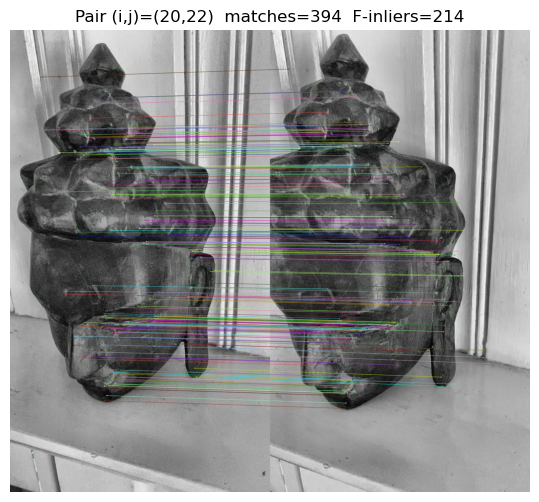

recover_pose_numpy: cheirality_inliers = 62 / 214  (det(R)=1.000)

=== Pair (i,j)=(20,22) ===
F =
 [[ 1.43903836e-08  7.36150049e-07 -5.70435853e-04]
 [-7.76804635e-07  3.73911233e-08  3.01339416e-03]
 [ 5.34711544e-04 -3.13644626e-03  9.82623868e-02]]
E =
 [[-0.00929721 -0.4219901  -0.04606424]
 [ 0.45192482 -0.01479683 -0.89066378]
 [ 0.07090402  0.90385241 -0.00157458]]
[pair 20-23] matches=285  F-inliers=136


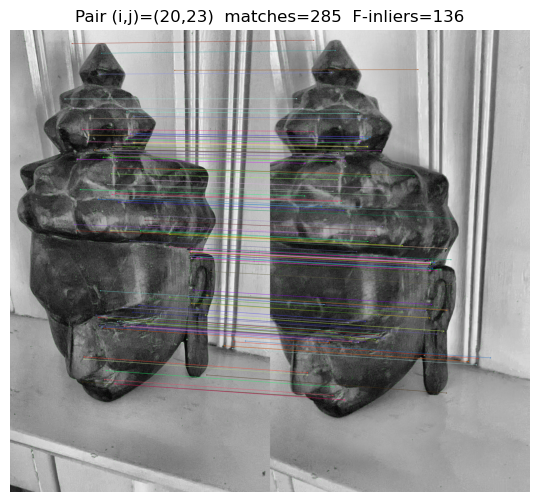

recover_pose_numpy: cheirality_inliers = 93 / 136  (det(R)=1.000)

=== Pair (i,j)=(20,23) ===
F =
 [[ 1.63223083e-08  1.08062583e-06 -2.29304817e-04]
 [-1.14498052e-06  3.69788346e-08  3.12863169e-03]
 [ 1.83611053e-04 -3.17641421e-03  3.99337031e-02]]
E =
 [[-0.00939301 -0.56493719 -0.24781282]
 [ 0.59112519 -0.02072234 -0.7668121 ]
 [ 0.27419669  0.77862469  0.00686395]]
[pair 20-24] matches=247  F-inliers=108


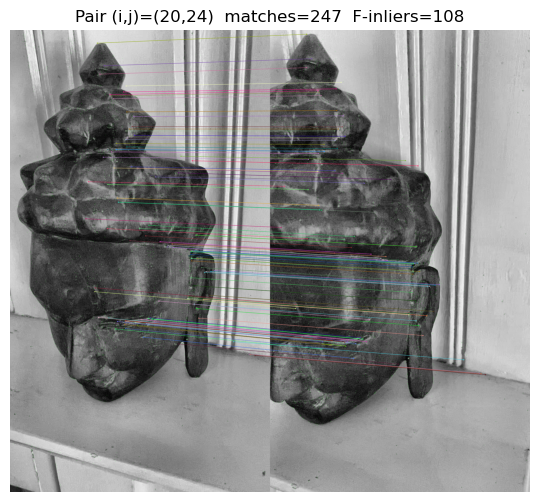

recover_pose_numpy: cheirality_inliers = 53 / 108  (det(R)=1.000)

=== Pair (i,j)=(20,24) ===
F =
 [[ 4.82309631e-08  1.10378505e-06 -4.49098932e-04]
 [-1.02147980e-06 -1.95364788e-08  3.25335454e-03]
 [ 2.47825219e-04 -3.29946293e-03  9.59742784e-02]]
E =
 [[ 0.01842988  0.55918227  0.19720103]
 [-0.53532495 -0.00091721  0.82327979]
 [-0.20607582 -0.8007631  -0.0059358 ]]
[pair 21-22] matches=518  F-inliers=360


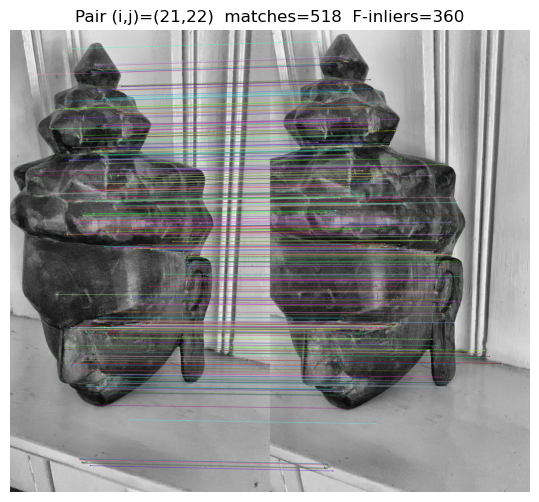

recover_pose_numpy: cheirality_inliers = 356 / 360  (det(R)=1.000)

=== Pair (i,j)=(21,22) ===
F =
 [[ 1.23654962e-08  1.21039057e-06 -1.48833895e-03]
 [-1.22789699e-06  1.81574608e-08  3.04177138e-03]
 [ 1.47947478e-03 -3.08643971e-03  2.51944841e-02]]
E =
 [[-8.01513256e-03 -6.49352476e-01  1.01534896e-01]
 [ 6.56572987e-01 -6.19842793e-03 -7.47264615e-01]
 [-9.41646271e-02  7.54698540e-01 -9.44897675e-05]]
[pair 21-23] matches=365  F-inliers=191


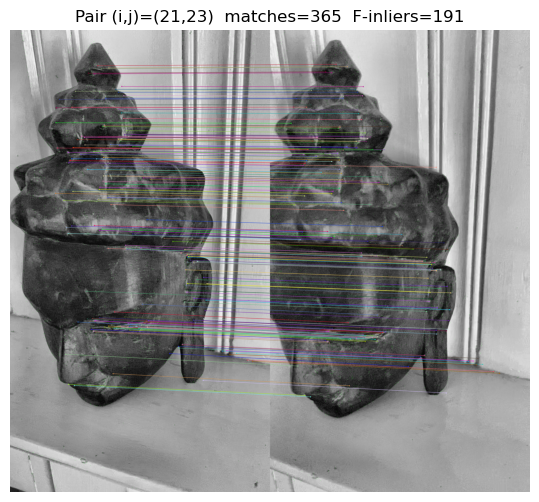

recover_pose_numpy: cheirality_inliers = 191 / 191  (det(R)=1.000)

=== Pair (i,j)=(21,23) ===
F =
 [[-2.02719287e-08 -1.19234285e-06  3.94786608e-04]
 [ 1.19820298e-06 -1.15203352e-08 -3.03294378e-03]
 [-3.39268826e-04  3.04277861e-03 -1.66661625e-02]]
E =
 [[-0.01001543 -0.63068549 -0.23537377]
 [ 0.63267393 -0.00795757 -0.73840717]
 [ 0.24541352  0.73546862  0.00283453]]
[pair 21-24] matches=377  F-inliers=188


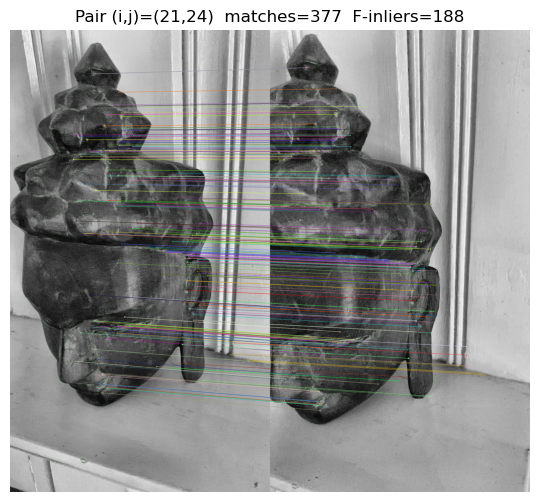

recover_pose_numpy: cheirality_inliers = 50 / 188  (det(R)=1.000)

=== Pair (i,j)=(21,24) ===
F =
 [[ 4.07988293e-08  2.29207819e-06 -1.27265030e-03]
 [-2.30813855e-06 -1.98177074e-08  3.64687077e-03]
 [ 1.21508807e-03 -3.39634484e-03 -1.23808603e-01]]
E =
 [[-1.15359906e-02 -8.55880730e-01 -2.08939645e-01]
 [ 8.38218082e-01 -2.38309721e-04 -5.05942109e-01]
 [ 2.05344039e-01  4.72125798e-01 -4.83237580e-03]]
[pair 22-23] matches=441  F-inliers=260


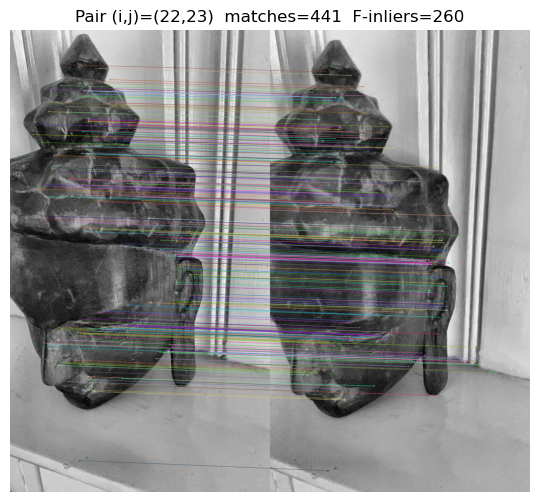

recover_pose_numpy: cheirality_inliers = 251 / 260  (det(R)=1.000)

=== Pair (i,j)=(22,23) ===
F =
 [[ 4.94487070e-09  9.41890472e-07  7.64974070e-04]
 [-9.44121549e-07  1.35577963e-08  2.29360971e-03]
 [-7.68688662e-04 -2.28447100e-03 -2.60550918e-02]]
E =
 [[-0.005542   -0.55171352 -0.56787872]
 [ 0.55288263 -0.00518871 -0.61041401]
 [ 0.57373342  0.60465891  0.00118884]]
[pair 22-24] matches=428  F-inliers=238


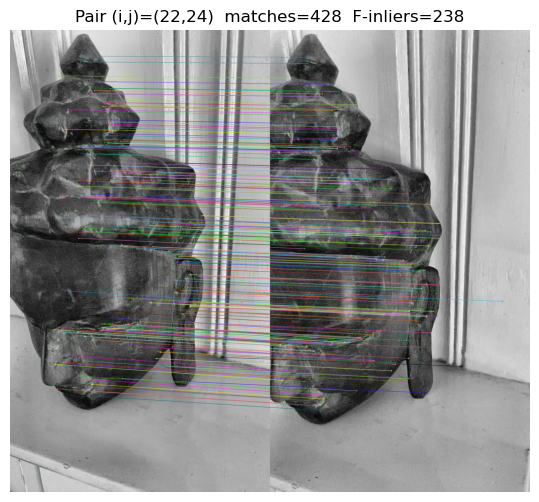

recover_pose_numpy: cheirality_inliers = 236 / 238  (det(R)=1.000)

=== Pair (i,j)=(22,24) ===
F =
 [[-3.69446430e-08 -2.50368929e-06  8.77106532e-04]
 [ 2.48622084e-06  2.47337047e-08 -3.41303738e-03]
 [-8.52282640e-04  3.17978717e-03  1.17496147e-01]]
E =
 [[-0.01170463 -0.87221636 -0.3145513 ]
 [ 0.8581926   0.0062399  -0.41261615]
 [ 0.30425488  0.37511928 -0.00938224]]
[pair 23-24] matches=376  F-inliers=237


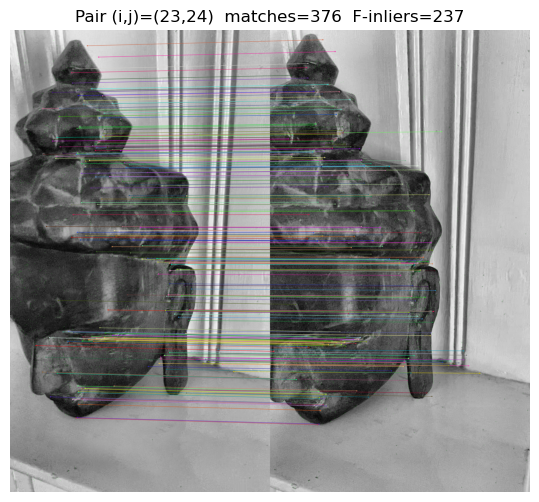

recover_pose_numpy: cheirality_inliers = 230 / 237  (det(R)=1.000)

=== Pair (i,j)=(23,24) ===
F =
 [[-2.56230602e-08  2.50370230e-06 -2.28671125e-03]
 [-2.48474072e-06 -3.19962474e-08  3.40283939e-03]
 [ 2.32561282e-03 -3.21897706e-03 -1.72430070e-01]]
E =
 [[ 9.70605773e-03 -9.14529104e-01 -2.20947990e-02]
 [ 9.02596995e-01  1.11569396e-02 -4.29879312e-01]
 [ 1.54014529e-02  4.03998448e-01  3.78510688e-04]]

===== SUMMARY =====
(i,j)=(1,2)  matches=625  F_inliers=578  cheirality=0/578
(i,j)=(1,3)  matches=336  F_inliers=221  cheirality=1/221
(i,j)=(1,4)  matches=255  F_inliers=147  cheirality=146/147
(i,j)=(1,5)  matches=163  F_inliers=81  cheirality=78/81
(i,j)=(2,3)  matches=527  F_inliers=363  cheirality=0/363
(i,j)=(2,4)  matches=442  F_inliers=281  cheirality=274/281
(i,j)=(2,5)  matches=315  F_inliers=173  cheirality=35/173
(i,j)=(2,6)  matches=230  F_inliers=93  cheirality=15/93
(i,j)=(3,4)  matches=441  F_inliers=302  cheirality=200/302
(i,j)=(3,5)  matches=274  F_inliers=155

In [8]:
USE_DIRECT_E = False     
E_THRESH = 1.0

K = np.array([[1715.73, 0.0, 540.0],
              [0.0, 1715.73, 960.0],
              [0.0, 0.0, 1.0]], dtype=np.float64)

RATIO = 0.85
M_MIN = 70
F_THRESH = 1.0
CONF = 0.999
ITERS = 5000

H, W = normalized_intensity_images[0].shape[:2]
print("Image size (W,H):", W, H)
print("K principal point (cx, cy):", K[0,2], K[1,2])

# Cache features
kpts_list, desc_list = [], []
for img in normalized_intensity_images:
    kp, des = detect_and_describe(img)
    if des is None:
        des = np.empty((0,128), dtype=np.float32)
    elif des.dtype != np.float32:
        des = des.astype(np.float32)
    kpts_list.append(kp)
    desc_list.append(des)

N = len(normalized_intensity_images)
all_results = []  # (i,j,F,E,n_matches,n_inliers,cheirality)

for i in range(N-1):
    for j in range(i+1, N):
        # a) match
        pairs, ptsA, ptsB = match_descriptors_with_points(
            kpts_list[i], desc_list[i], kpts_list[j], desc_list[j], ratio=RATIO
        )
        n_matches = len(pairs)
        if n_matches < M_MIN:
            continue

        # b) robust F via RANSAC
        F, inl = ransac_F_eight_point(ptsA, ptsB, thresh_px=F_THRESH,
                                      max_iters=ITERS, confidence=CONF, rng_seed=0)
        if F is None or inl is None:
            continue
        inl = inl.astype(bool)
        n_inl = int(inl.sum())
        print(f"[pair {i+1}-{j+1}] matches={n_matches}  F-inliers={n_inl}")
        if n_inl < M_MIN:
            continue

        F_refined = F  # ransac already refits on inliers

        # c) visualize inliers
        inlier_pairs = [pairs[k] for k, keep in enumerate(inl) if keep]
        stitched = visualize_pair(
            normalized_intensity_images[i],
            normalized_intensity_images[j],
            kpts_list[i], kpts_list[j],
            inlier_pairs
        )
        plt.figure(figsize=(12,6))
        plt.title(f"Pair (i,j)=({i+1},{j+1})  matches={n_matches}  F-inliers={n_inl}")
        plt.imshow(stitched); plt.axis('off'); plt.show()

        # d) Essential matrix
        if USE_DIRECT_E:
            E_used, maskE = cv2.findEssentialMat(ptsA, ptsB, K, method=cv2.RANSAC,
                                                 prob=CONF, threshold=E_THRESH, maxIters=ITERS)
            if E_used is None:
                # fallback to F -> E
                E_used = E_from_F(F_refined, K, K)
            elif E_used.size != 9:
                E_used = E_used.reshape(-1,3,3)[0]
        else:
            E_used = E_from_F(F_refined, K, K)

        # e) Pose sanity via recoverPose on inlier-filtered points
        ptsA_in = ptsA[inl].astype(np.float32)
        ptsB_in = ptsB[inl].astype(np.float32)

        cheirality_inliers = 0
        if len(ptsA_in) >= 5:
          #  retval, R, t, mask_pose = cv2.recoverPose(E_used, ptsA_in, ptsB_in, K)
          #  cheirality_inliers = int(np.count_nonzero(mask_pose))  
         #   denom = len(ptsA_in)
         #   print(f"recoverPose: cheirality_inliers = {cheirality_inliers} / {denom}  (det(R)={np.linalg.det(R):.3f})")
            R, t, mask_pose, X3d = recover_pose_from_E_numpy(E_used, ptsA_in, ptsB_in, K, reproj_thresh_norm=2e-3, min_parallax_deg=0.5)      # optional
            cheirality_inliers = int(mask_pose.sum())
            denom = len(ptsA_in)
            print(f"recover_pose_numpy: cheirality_inliers = {cheirality_inliers} / {denom}  (det(R)={np.linalg.det(R):.3f})")
        else:
            print("recoverPose skipped: too few inlier points")

        # f) record + print matrices
        all_results.append((i, j, F_refined, E_used, n_matches, n_inl, cheirality_inliers))
        print(f"\n=== Pair (i,j)=({i+1},{j+1}) ===")
        print("F =\n", F_refined)
        print("E =\n", E_used)

# Summary
print("\n===== SUMMARY =====")
for (i, j, F_refined, E_used, n_matches, n_inl, che_inl) in all_results:
    print(f"(i,j)=({i+1},{j+1})  matches={n_matches}  F_inliers={n_inl}  cheirality={che_inl}/{n_inl}")


In [9]:
def triangulate_dlt_norm(x1_hat, x2_hat, R, t):
    N = x1_hat.shape[0]
    X = np.zeros((N,3), dtype=np.float64)
    P1 = np.hstack([np.eye(3), np.zeros((3,1))])      # [I|0]
    P2 = np.hstack([R, t.reshape(3,1)])               # [R|t]
    for k in range(N):
        x1, y1 = x1_hat[k]
        x2, y2 = x2_hat[k]
        A = np.stack([
            x1*P1[2]-P1[0],
            y1*P1[2]-P1[1],
            x2*P2[2]-P2[0],
            y2*P2[2]-P2[1],
        ], axis=0)
        _, _, Vt = np.linalg.svd(A)
        Xh = Vt[-1]
        X[k] = (Xh[:3] / Xh[3])
    return X

def project_points(P, X):
    Xh = np.hstack([X, np.ones((X.shape[0],1))])
    x = (P @ Xh.T).T
    return x[:, :2] / x[:, 2:3]

def reprojection_errors_px(P1, P2, X, pts1, pts2):
    x1p = project_points(P1, X)
    x2p = project_points(P2, X)
    e1 = np.linalg.norm(x1p - pts1, axis=1)
    e2 = np.linalg.norm(x2p - pts2, axis=1)
    return 0.5*(e1 + e2)

def parallax_degrees(x1_hat, x2_hat, R, t):
    v1 = np.hstack([x1_hat, np.ones((x1_hat.shape[0],1))])
    v1 = v1 / np.linalg.norm(v1, axis=1, keepdims=True)
    v2c2 = np.hstack([x2_hat, np.ones((x2_hat.shape[0],1))])
    v2_in_cam1 = (R.T @ v2c2.T).T
    v2_in_cam1 = v2_in_cam1 / np.linalg.norm(v2_in_cam1, axis=1, keepdims=True)
    dots = np.clip(np.sum(v1*v2_in_cam1, axis=1), -1.0, 1.0)
    return np.degrees(np.arccos(dots))

def recover_kp_indices_from_pixels(kpts, obs_px, tol=1.0):
    # Map each observed pixel (M,2) to a nearest keypoint index in 'kpts' within 'tol' px.
    xy = np.array([kp.pt for kp in kpts], dtype=np.float64)
    out = -np.ones(obs_px.shape[0], dtype=int)
    for m, p in enumerate(obs_px):
        d2 = np.sum((xy - p[None,:])**2, axis=1)
        j = int(np.argmin(d2))
        if np.sqrt(d2[j]) <= tol:
            out[m] = j
    return out

In [10]:
# Tunables
PX_THR        = 1.5
ANGL_THR_DEG  = 2.0
IMG_A_ID, IMG_B_ID, IMG_NEW_ID = 17, 18, 19   # seed pair and first new image

# ID helpers
def id2idx(img_id_1b: int) -> int:  # 1-based -> 0-based
    return img_id_1b - 1
def idx2id(idx_0b: int) -> int:     # 0-based -> 1-based
    return idx_0b + 1

# Global map containers
N = len(kpts_list)
cameras = {}  # cameras[idx] = {'R': Rcw, 't': tcw}  (world->cam of image idx)
tracks  = {}  # tracks[tid] = {'X': (3,), 'obs': [(img_idx, (u,v)), ...]}
kp2track = [defaultdict(lambda: -1) for _ in range(N)]  # per-image: kp_idx -> tid
_next_track_id = 0
def _new_track_id():
    global _next_track_id
    tid = _next_track_id; _next_track_id += 1
    return tid
def add_track(X, obs_list):
    tid = _new_track_id()
    tracks[tid] = {'X': np.asarray(X, float).reshape(3,), 'obs': []}
    for img_idx, kp_idx, uv in obs_list:
        tracks[tid]['obs'].append((img_idx, tuple(map(float, uv))))
        kp2track[img_idx][int(kp_idx)] = tid
    return tid

# Matching-based 2D–3D gather + PnP register + neighbor triangulate
def gather_2d3d_for_image(img_idx, neighbor_idxs):
    pts3d, pts2d = [], []
    img_kp_to_tid = {}
    for nb in neighbor_idxs:
        pairs, _, _ = match_descriptors_with_points(
            kpts_list[nb], desc_list[nb], kpts_list[img_idx], desc_list[img_idx], ratio=RATIO
        )
        for (i_nb, i_new) in pairs:
            tid = kp2track[nb].get(i_nb, -1)
            if tid >= 0:
                X = tracks[tid]['X']
                u, v = kpts_list[img_idx][i_new].pt
                pts3d.append(X); pts2d.append([u, v])
                img_kp_to_tid.setdefault(i_new, tid)
    if not pts3d:
        return np.zeros((0,3), np.float32), np.zeros((0,2), np.float32), {}
    return np.asarray(pts3d, np.float32), np.asarray(pts2d, np.float32), img_kp_to_tid

def register_image_via_pnp(new_idx, support_from, px_thr=1.5):
    pts3d, pts2d, kp_to_tid = gather_2d3d_for_image(new_idx, support_from)
    if len(pts3d) < 6:
        print(f"[PnP {idx2id(new_idx)}] not enough 2D–3D ({len(pts3d)})."); return False
    ok, rvec, tvec, inliers = cv2.solvePnPRansac(
        pts3d, pts2d, K, None, iterationsCount=2000,
        reprojectionError=px_thr, confidence=0.999, flags=cv2.SOLVEPNP_EPNP
    )
    if not ok or inliers is None or len(inliers) < 6:
        print(f"[PnP {idx2id(new_idx)}] RANSAC failed or too few inliers."); return False
    mask = inliers.ravel()
    ok, rvec, tvec = cv2.solvePnP(
        pts3d[mask], pts2d[mask], K, None, rvec, tvec,
        useExtrinsicGuess=True, flags=cv2.SOLVEPNP_ITERATIVE
    )
    R, _ = cv2.Rodrigues(rvec); t = tvec.reshape(3,1)
    cameras[new_idx] = {'R': R, 't': t}
    # add obs for inliers in this new image
    for idx in inliers.ravel().tolist():
        uv = tuple(pts2d[idx])
        # find nearest keypoint that produced uv
        xy = np.array([kp.pt for kp in kpts_list[new_idx]])
        jmin = int(np.argmin(np.sum((xy - uv)**2, axis=1)))
        if np.linalg.norm(xy[jmin] - uv) <= 1.0:
            tid = kp_to_tid.get(jmin, None)
            if tid is None:  # fall back by uv
                # nearest existing mapping by distance in uv
                for kp_idx, tid2 in kp_to_tid.items():
                    if np.linalg.norm(xy[kp_idx] - uv) <= 1.0:
                        tid = tid2; jmin = kp_idx; break
            if tid is not None and kp2track[new_idx][jmin] == -1:
                tracks[tid]['obs'].append((new_idx, tuple(map(float, xy[jmin]))))
                kp2track[new_idx][jmin] = tid
    print(f"[PnP {idx2id(new_idx)}] inliers {len(inliers)}/{len(pts2d)}")
    return True

def triangulate_with_neighbor(a_idx, b_idx, px_thr=1.5, ang_thr_deg=2.0, exclude_existing=True):
    assert a_idx in cameras and b_idx in cameras
    pairs, _, _ = match_descriptors_with_points(
        kpts_list[a_idx], desc_list[a_idx], kpts_list[b_idx], desc_list[b_idx], ratio=RATIO
    )
    if len(pairs) < 8:
        return 0
    ptsA = np.array([kpts_list[a_idx][iA].pt for (iA, _) in pairs], dtype=np.float32)
    ptsB = np.array([kpts_list[b_idx][iB].pt for (_, iB) in pairs], dtype=np.float32)
    F_ab, inl = ransac_F_eight_point(ptsA, ptsB, thresh_px=F_THRESH, max_iters=ITERS, confidence=CONF, rng_seed=0)
    if F_ab is None or inl is None:
        return 0
    inl = inl.astype(bool)
    pairs_inl = [p for p, keep in zip(pairs, inl) if keep]
    ptsA_inl  = ptsA[inl]; ptsB_inl = ptsB[inl]

    if exclude_existing:
        mask_new = np.array([kp2track[a_idx].get(p[0], -1) == -1 and kp2track[b_idx].get(p[1], -1) == -1
                             for p in pairs_inl], bool)
    else:
        mask_new = np.ones(len(pairs_inl), bool)
    if mask_new.sum() == 0:
        return 0

    ptsA_new = ptsA_inl[mask_new]; ptsB_new = ptsB_inl[mask_new]
    pairs_new = [p for p, m in zip(pairs_inl, mask_new) if m]

    # normalize
    Kinv = np.linalg.inv(K)
    A_h = np.hstack([ptsA_new, np.ones((len(ptsA_new),1))])
    B_h = np.hstack([ptsB_new, np.ones((len(ptsB_new),1))])
    xA = (Kinv @ A_h.T).T; xA = xA[:,:2] / xA[:,2:3]
    xB = (Kinv @ B_h.T).T; xB = xB[:,:2] / xB[:,2:3]

    Ra, ta = cameras[a_idx]['R'], cameras[a_idx]['t']
    Rb, tb = cameras[b_idx]['R'], cameras[b_idx]['t']
    R_rel = Rb @ Ra.T
    t_rel = (tb - Rb @ Ra.T @ ta).reshape(3,1)

    X_a = triangulate_dlt_norm(xA, xB, R_rel, t_rel)
    X_w = (Ra.T @ (X_a.T - ta)).T

    P_a = K @ np.hstack([Ra, ta])
    P_b = K @ np.hstack([Rb, tb])

    Zw = X_w[:,2]
    X_b = (Rb @ X_w.T + tb).T
    Zb = X_b[:,2]
    m_cheir = (Zw > 0) & (Zb > 0)

    err = reprojection_errors_px(P_a, P_b, X_w, ptsA_new, ptsB_new)
    m_reproj = (err < px_thr)

    ang = parallax_degrees(xA, xB, R_rel, t_rel)
    m_par = (ang >= ang_thr_deg)

    keep = m_cheir & m_reproj & m_par
    kept_idx = np.where(keep)[0]
    for idx in kept_idx:
        iA, iB = pairs_new[idx]
        X = X_w[idx]
        add_track(X, [(a_idx, iA, kpts_list[a_idx][iA].pt),
                      (b_idx, iB, kpts_list[b_idx][iB].pt)])
    return int(len(kept_idx))

def pick_support_neighbors(img_idx, k_top=3):
    regs = sorted(cameras.keys())
    return sorted([r for r in regs if r != img_idx], key=lambda x: abs(x - img_idx))[:k_top]

def process_image(img_idx):
    if img_idx in cameras:
        return
    support = pick_support_neighbors(img_idx, k_top=4)
    if not register_image_via_pnp(img_idx, support_from=support, px_thr=PX_THR):
        return
    # triangulate with up to 2 closest registered neighbors
    added_total = 0
    for nb in pick_support_neighbors(img_idx, k_top=2):
        added_total += triangulate_with_neighbor(nb, img_idx, px_thr=PX_THR, ang_thr_deg=ANGL_THR_DEG, exclude_existing=True)
    print(f"[DONE] cam {idx2id(img_idx)} registered, new_pts={added_total}, total_tracks={len(tracks)}")

# 1) Two-view seeding: images 17 and 18
i, j, k = id2idx(IMG_A_ID), id2idx(IMG_B_ID), id2idx(IMG_NEW_ID)

# 17 <-> 18 matches
pairs_17_18, ptsA, ptsB = match_descriptors_with_points(
    kpts_list[i], desc_list[i], kpts_list[j], desc_list[j], ratio=RATIO
)
F_18, inl = ransac_F_eight_point(ptsA, ptsB, thresh_px=F_THRESH, max_iters=ITERS, confidence=CONF, rng_seed=0)
inl = inl.astype(bool)

# Pose 17 -> 18
E_18 = E_from_F(F_18, K, K)
_, R_18, t_18, _ = cv2.recoverPose(E_18,
    ptsA[inl].astype(np.float32), ptsB[inl].astype(np.float32), K)

# rays & triangulate in cam-17
x17 = cv2.undistortPoints(ptsA[inl].reshape(-1,1,2), K, None).reshape(-1,2)
x18 = cv2.undistortPoints(ptsB[inl].reshape(-1,1,2), K, None).reshape(-1,2)
seed_points_X = triangulate_dlt_norm(x17, x18, R_18, t_18)

# map kp indices for 17 and 18 (tolerant nearest)
def recover_kp_indices_from_pixels(kpts, pix, tol=1.0):
    xy = np.array([kp.pt for kp in kpts])
    out = []
    for uv in pix:
        d2 = np.sum((xy - uv)**2, axis=1)
        jmin = int(np.argmin(d2))
        out.append(jmin if np.sqrt(d2[jmin]) <= tol else -1)
    return np.asarray(out, int)

idx17 = recover_kp_indices_from_pixels(kpts_list[i], ptsA[inl], tol=1.0)
idx18 = recover_kp_indices_from_pixels(kpts_list[j], ptsB[inl], tol=1.0)

# Seed cameras
cameras[i] = {'R': np.eye(3), 't': np.zeros((3,1))}
cameras[j] = {'R': R_18.copy(), 't': t_18.copy()}

# Seed tracks from 17–18
for m, X in enumerate(seed_points_X):
    o = []
    if idx17[m] >= 0: o.append((i, idx17[m], kpts_list[i][idx17[m]].pt))
    if idx18[m] >= 0: o.append((j, idx18[m], kpts_list[j][idx18[m]].pt))
    if o: add_track(X, o)

print(f"[INIT] Cameras: {[idx2id(x) for x in sorted(cameras.keys())]}  |  Tracks: {len(tracks)}")

# 2) Register image 19 and triangulate with neighbors
register_image_via_pnp(k, support_from=[i, j], px_thr=PX_THR)
for nb in pick_support_neighbors(k, k_top=2):
    triangulate_with_neighbor(nb, k, px_thr=PX_THR, ang_thr_deg=ANGL_THR_DEG, exclude_existing=True)
print(f"[INIT+] After 19: cams={sorted(map(idx2id, cameras.keys()))}, tracks={len(tracks)}")

# 3) Grow map: right pass (20..29) then left pass (16..1)
right_start_idx = min(id2idx(20), N-1)
right_end_idx   = min(id2idx(29), N-1)
left_start_idx  = max(id2idx(16), 0)
left_end_idx    = 0

for idx in range(right_start_idx, right_end_idx + 1):
    process_image(idx)

for idx in range(left_start_idx, left_end_idx - 1, -1):
    process_image(idx)

print(f"\n[SUMMARY] Registered cameras: {[idx2id(x) for x in sorted(cameras.keys())]}")
print(f"[SUMMARY] Total tracks: {len(tracks)}")


[INIT] Cameras: [17, 18]  |  Tracks: 285
[PnP 19] inliers 131/271
[INIT+] After 19: cams=[17, 18, 19], tracks=392
[PnP 20] inliers 111/325
[DONE] cam 20 registered, new_pts=238, total_tracks=630
[PnP 21] inliers 203/540
[DONE] cam 21 registered, new_pts=240, total_tracks=870
[PnP 22] inliers 197/591
[DONE] cam 22 registered, new_pts=267, total_tracks=1137
[PnP 23] inliers 197/610
[DONE] cam 23 registered, new_pts=71, total_tracks=1208
[PnP 24] inliers 156/551
[DONE] cam 24 registered, new_pts=128, total_tracks=1336
[PnP 16] inliers 147/451
[DONE] cam 16 registered, new_pts=91, total_tracks=1427
[PnP 15] inliers 100/372
[DONE] cam 15 registered, new_pts=185, total_tracks=1612
[PnP 14] inliers 73/224
[DONE] cam 14 registered, new_pts=97, total_tracks=1709
[PnP 13] inliers 71/191
[DONE] cam 13 registered, new_pts=152, total_tracks=1861
[PnP 12] inliers 157/297
[DONE] cam 12 registered, new_pts=149, total_tracks=2010
[PnP 11] inliers 158/336
[DONE] cam 11 registered, new_pts=193, total_tra

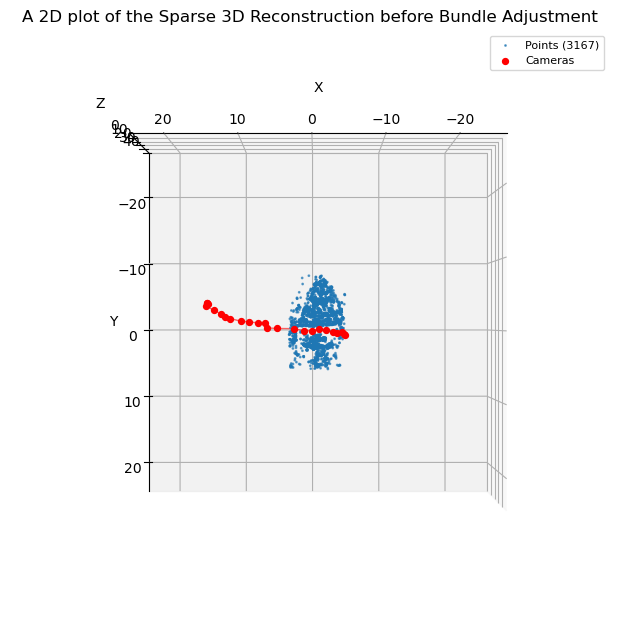

In [11]:
import copy

cameras_raw = copy.deepcopy(cameras)   # poses as built
tracks_raw  = copy.deepcopy(tracks)    # all tracks/obs as built

# helpers
def _cam_centers_world(cameras):
    return np.array([np.asarray(cameras[i]['t'], float).ravel()
                     for i in sorted(cameras.keys())]) if cameras else np.zeros((0,3))


def _reorder_and_flip(X, order=("x","y","z"), flips=("y",)):
    col = {"x":0, "y":1, "z":2}
    Y = X[:, [col[a] for a in order]].copy()
    for a in flips:
        Y[:, order.index(a)] *= -1
    return Y, order

def _axis_equal_3d(ax, X, C=None, robust=True, pct=97, k_mad=6.0):
    if X.size == 0 and (C is None or C.size == 0):
        return
    if C is not None and C.size:
        X = np.vstack([X, C])

    X = X[np.isfinite(X).all(axis=1)]
    if X.size == 0:
        return

    if not robust:
        mins = X.min(axis=0); maxs = X.max(axis=0)
        ctr  = (mins + maxs)/2.0
        r    = (maxs - mins).max() * 0.55
    else:
        ctr = np.median(X, axis=0)
        d   = np.abs(X - ctr)
        r_p = np.percentile(d, pct, axis=0)           # per-axis robust radius
        mad = 1.4826 * np.median(d, axis=0)           # robust sigma
        r_m = k_mad * mad
        r   = np.max(np.vstack([r_p, r_m]), axis=0).max()
        if not np.isfinite(r) or r < 1e-6: r = 1.0

    ax.set_xlim(ctr[0]-r, ctr[0]+r)
    ax.set_ylim(ctr[1]-r, ctr[1]+r)
    ax.set_zlim(ctr[2]-r, ctr[2]+r)
    try: ax.set_box_aspect((1,1,1))
    except Exception: pass

def plot_sparse_map_3d_before_BA(
    cameras, tracks, max_points=120000,
    title="A 2D plot of the Sparse 3D Reconstruction before Bundle Adjustment",
    axis_order=("x","y","z"), flips=("y",),
    elev=30, azim=-135,
    robust_axes=True, pct=97,         # robust axis scaling
    clip_outliers=True, clip_pct=97,  # clip extreme point outliers
):
    # points
    Xs = [d['X'] for d in tracks.values()]
    if not Xs:
        print("No points to plot."); return
    X = np.asarray(Xs, float)
    if len(X) > max_points:
        X = X[np.random.choice(len(X), size=max_points, replace=False)]

    # cameras
    C = _cam_centers_world(cameras)

    # axis reorder + flips
    Xv, order = _reorder_and_flip(X, axis_order, flips)
    Cv, _     = _reorder_and_flip(C, axis_order, flips) if C.size else (C, order)

    # robust clipping for the scatter only
    Xplot = Xv
    if clip_outliers and Xv.size:
        ctr = np.median(Xv, axis=0)
        d   = np.abs(Xv - ctr)
        thr = np.percentile(d, clip_pct, axis=0)
        keep = (d <= thr).all(axis=1)
        if np.count_nonzero(keep) >= 10:
            Xplot = Xv[keep]

    # draw
    fig = plt.figure(figsize=(7.5, 6.5))
    ax  = fig.add_subplot(111, projection='3d')

    if Xplot.size:
        ax.scatter(Xplot[:,0], Xplot[:,1], Xplot[:,2], s=1, alpha=0.65, label=f'Points ({len(Xplot)})')
    if Cv.size:
        ax.scatter(Cv[:,0], Cv[:,1], Cv[:,2], s=18, c='r', depthshade=False, label='Cameras')
        ax.plot(Cv[:,0], Cv[:,1], Cv[:,2], linewidth=1.0, alpha=0.6, c='r')

    ax.set_xlabel(order[0].upper()); ax.set_ylabel(order[1].upper()); ax.set_zlabel(order[2].upper())
    ax.set_title(title)
    ax.grid(True, alpha=0.25); ax.legend(loc='upper right', fontsize=8)

    both = Xv if not Cv.size else np.vstack([Xv, Cv])
    _axis_equal_3d(ax, both, robust=robust_axes, pct=pct)

    ax.view_init(elev=elev, azim=azim)
    plt.tight_layout(); plt.show()

plot_sparse_map_3d_before_BA(
    cameras_raw, tracks_raw,
 #   title=f"Before BA (raw/noisy) — RMSE={rmse_noisy:.1f}px, meas={n_noisy}",
    axis_order=("x","z","y"), flips=(),
    elev=180, azim=90,
    robust_axes=True, pct=97,
    clip_outliers=True, clip_pct=97
)


In [12]:
def _extract_two_numbers(obj):
    # Depth-first: yield numeric scalars from any nested obj.
    if isinstance(obj, np.generic):
        val = obj.item()
        if isinstance(val, numbers.Number):
            yield float(val); return
    if isinstance(obj, numbers.Number):
        yield float(obj); return
    if isinstance(obj, str):
        try:
            yield float(obj); return
        except:
            for tok in re.split(r'[,;\s]+', obj.strip()):
                if not tok: continue
                try: yield float(tok)
                except: pass
            return
    if isinstance(obj, dict):
        for k in ('u','v','x','y','col','row'):
            if k in obj: 
                yield from _extract_two_numbers(obj[k])
        for v in obj.values():
            yield from _extract_two_numbers(v)
        return
    if isinstance(obj, (list, tuple, set)) or isinstance(obj, np.ndarray):
        try: it = obj if not isinstance(obj, np.ndarray) else obj.tolist()
        except Exception: it = [obj]
        for x in it:
            yield from _extract_two_numbers(x)
        return
    return

def _to_uv2_any(uv_like):
    it = _extract_two_numbers(uv_like)
    try:
        u = next(it); v = next(it)
        return float(u), float(v)
    except StopIteration:
        return None

def _coerce_cid(cid):
    try:
        return int(cid)
    except Exception:
        m = re.search(r'-?\d+', str(cid))
        if m: return int(m.group(0))
        raise ValueError(f"Bad cam id: {cid}")

def normalize_obs_inplace(tracks, cameras):
    # Normalize tracks[*]['obs'] to a list of (int cid, (u,v)) in pixels.    
    cam_keys = set(cameras.keys())
    all_cids = []
    malformed_uv = 0
    total_in = 0

    for tr in tracks.values():
        obs = tr.get('obs', [])
        new = []
        for o in obs:
            total_in += 1
            # extract cid, uv candidate
            if isinstance(o, dict):
                cid = o.get('cid') or o.get('cam_id') or o.get('camera') or o.get('cam')
                uv  = o.get('uv') or o.get('z') or (o.get('u'), o.get('v'))
            elif isinstance(o, (list, tuple)):
                if len(o) >= 3: cid, uv = o[0], (o[1], o[2])
                elif len(o) == 2: cid, uv = o
                else: continue
            else:
                continue

            try:
                cid = _coerce_cid(cid)
            except Exception:
                continue

            uv2 = _to_uv2_any(uv)
            if uv2 is None:
                malformed_uv += 1
                continue

            new.append((cid, uv2))
            all_cids.append(cid)

        tr['obs'] = new  # normalized

    if not all_cids:
        print(f"[normalize_obs_inplace] 0 usable obs after parsing "
              f"(malformed_uv={malformed_uv}, total_seen={total_in}).")
        return

    obs_cids = set(all_cids)

    # Pure off-by-one (1..N) -> (0..N-1) fix
    if cam_keys and min(cam_keys) == 0 and min(obs_cids) >= 1 and {c-1 for c in obs_cids} == cam_keys:
        for tr in tracks.values():
            tr['obs'] = [(c-1, uv) for (c, uv) in tr['obs']]
        print("[normalize_obs_inplace] Shifted obs camera IDs by -1 (1-based → 0-based).")
    else:
        missing = sorted((obs_cids - cam_keys))[:10]
        if missing:
            print("[normalize_obs_inplace] WARNING: obs reference cams not present:", missing, "...")

    total_out = sum(len(tr.get('obs', [])) for tr in tracks.values())
    print(f"[normalize_obs_inplace] Normalized obs: {total_out} (malformed_uv skipped: {malformed_uv})")

# Pose/Camera helpers
def _cal3_from_K(K: np.ndarray) -> gtsam.Cal3_S2:
    fx, fy = float(K[0,0]), float(K[1,1])
    cx, cy = float(K[0,2]), float(K[1,2])
    skew   = float(K[0,1]) if abs(K[0,1]) > 1e-12 else 0.0
    return gtsam.Cal3_S2(fx, fy, skew, cx, cy)

def _pose_wrt_world_from_Rt_world_to_cam(Rcw: np.ndarray, tcw: np.ndarray) -> gtsam.Pose3:
    Rwc = Rcw.T
    twc = -Rwc @ tcw.reshape(3,)
    return gtsam.Pose3(gtsam.Rot3(Rwc), gtsam.Point3(*twc))

def _Rt_world_to_cam_from_pose_w(pose_w_c: gtsam.Pose3):
    Rwc = pose_w_c.rotation().matrix()
    twc = np.asarray(pose_w_c.translation()).reshape(3,)
    Rcw = Rwc.T
    tcw = -Rcw @ twc
    return Rcw, tcw

def _camera_centers_from_dict(cameras):
    C = {}
    for cid, cam in cameras.items():
        Rcw, tcw = cam['R'], cam['t']
        Rwc = Rcw.T
        twc = -Rwc @ tcw.reshape(3,)
        C[cid] = twc  # camera center in world
    return C

# RMSE 
def _reprojection_rmse(cameras, tracks, K: np.ndarray):
    Kcal = _cal3_from_K(K)
    err2, n = 0.0, 0
    cam_keys = set(cameras.keys())

    for tr in tracks.values():
        X = np.asarray(tr['X']).reshape(3,)
        for (cid, (u,v)) in tr.get('obs', []): 
            if cid not in cam_keys:
                continue
            Rcw, tcw = cameras[cid]['R'], cameras[cid]['t']
            pose = _pose_wrt_world_from_Rt_world_to_cam(Rcw, tcw)
            cam  = gtsam.PinholeCameraCal3_S2(pose, Kcal)
            try:
                zhat = cam.project(gtsam.Point3(*X))
                if hasattr(zhat, "x"):
                    uhat, vhat = float(zhat.x()), float(zhat.y())
                else:
                    zhat = np.asarray(zhat, dtype=float).reshape(-1)
                    uhat, vhat = float(zhat[0]), float(zhat[1])

                du = uhat - float(u)
                dv = vhat - float(v)
                err2 += du*du + dv*dv
                n += 1
            except RuntimeError:
                # point behind camera etc.
                pass

    if n == 0:
        print("[RMSE] 0 measurements used — check normalization / camera IDs.")
        return 0.0, 0
    return (err2 / n) ** 0.5, n


def prepare_tracks_for_ba_strict(tracks, cameras, min_distinct_cams=2, min_angle_deg=1.0):
    C = _camera_centers_from_dict(cameras)
    valid_cids = set(cameras.keys())

    kept = {}
    dropped_single_view = 0
    dropped_no_obs = 0
    dropped_small_angle = 0
    total_obs_kept = 0

    for tid, tr in tracks.items():
        obs = tr.get('obs', [])
        # keep only obs referencing existing cams
        obs = [(cid, uv) for (cid, uv) in obs if cid in valid_cids]
        if len(obs) == 0:
            dropped_no_obs += 1
            continue

        seen = set()
        obs_dedup = []
        for (cid, uv) in obs:
            if cid in seen:
                continue
            seen.add(cid)
            obs_dedup.append((cid, uv))

        if len(seen) < min_distinct_cams:
            dropped_single_view += 1
            continue

        # parallax check
        X = np.asarray(tr.get('X', [np.nan, np.nan, np.nan]), dtype=float).reshape(3,)
        cids = [cid for (cid, _) in obs_dedup]
        best_angle = 0.0
        for i in range(len(cids)):
            for j in range(i+1, len(cids)):
                Ci = np.asarray(C[cids[i]]); Cj = np.asarray(C[cids[j]])
                if np.any(np.isnan(X)):
                    baseline = np.linalg.norm(Ci - Cj)
                    mid = 0.5*(Ci + Cj)
                    dist = np.linalg.norm(mid - Ci) + 1e-9
                    angle = np.degrees(np.arctan2(baseline, dist))
                else:
                    v1 = Ci - X; v2 = Cj - X
                    n1 = np.linalg.norm(v1); n2 = np.linalg.norm(v2)
                    if n1 < 1e-9 or n2 < 1e-9:
                        angle = 0.0
                    else:
                        c = float(np.dot(v1, v2) / (n1 * n2))
                        c = max(min(c, 1.0), -1.0)
                        angle = np.degrees(np.arccos(c))
                if angle > best_angle:
                    best_angle = angle

        if best_angle < min_angle_deg:
            dropped_small_angle += 1
            continue

        kept[tid] = {'X': X, 'obs': obs_dedup}
        total_obs_kept += len(obs_dedup)

   # print(f"[prepare_tracks_for_ba_strict] kept {len(kept)} tracks ({total_obs_kept} obs), "
    #      f"dropped_single_view={dropped_single_view}, dropped_no_obs={dropped_no_obs}, "
   #       f"dropped_small_angle={dropped_small_angle}, min_angle_deg={min_angle_deg}")
    return kept

def convert_obs_to_pixels_inplace(tracks, K, auto_detect=True, threshold=5.0):
    # Convert (u,v) in each track's obs to pixel units using K. 
    fx, fy = float(K[0,0]), float(K[1,1])
    cx, cy = float(K[0,2]), float(K[1,2])
    s  = float(K[0,1])  # skew

    if auto_detect:
        us, vs = [], []
        for tr in tracks.values():
            for _, (u,v) in tr.get('obs', []):
                us.append(float(u)); vs.append(float(v))
        if not us:
            print("[convert_obs_to_pixels_inplace] No obs to convert.")
            return
        max_abs = max(abs(max(us, default=0.0)), abs(min(us, default=0.0)),
                      abs(max(vs, default=0.0)), abs(min(vs, default=0.0)))
        normalized = (max_abs < threshold) 
    else:
        normalized = True

    if not normalized:
        print("[convert_obs_to_pixels_inplace] Obs already look like pixels; no change.")
        return
        
    nconv = 0
    for tr in tracks.values():
        new_obs = []
        for cid, (x, y) in tr.get('obs', []):
            u = fx * float(x) + s * float(y) + cx
            v = fy * float(y) + cy
            new_obs.append((cid, (u, v)))
            nconv += 1
        tr['obs'] = new_obs
 #   print(f"[convert_obs_to_pixels_inplace] Converted {nconv} observations from normalized to pixels.")

def guess_image_size_from_obs(tracks):
    us, vs = [], []
    for tr in tracks.values():
        for _, (u,v) in tr.get('obs', []):
            us.append(float(u)); vs.append(float(v))
    if not us:
        return None
    return (max(us), max(vs)) 

def fit_intrinsics_scale(cameras, tracks, K, s_grid=None, verbose=True):    
    if s_grid is None:
        s_grid = np.array([0.25, 0.33, 0.5, 0.667, 0.75, 0.9, 1.0, 1.1, 1.25, 1.5, 1.75, 2.0, 2.25, 2.5, 3.0, 3.5, 4.0])
    scores = []
    for s in s_grid:
        Kt = _scale_K(K, s)
        rmse, _ = _reprojection_rmse(cameras, tracks, Kt)
        scores.append((rmse, s))
    rmse_best, s_best = min(scores, key=lambda x: x[0])
    if verbose:
        print("Scale search (s → RMSE px):")
        print(", ".join([f"{s:.3g}→{r:.1f}" for (r,s) in sorted([(r,s) for (r,s) in scores], key=lambda x: x[1])]))
        print(f"Chosen s={s_best:.6g}, pre-BA RMSE={rmse_best:.2f}px")
    return _scale_K(K, s_best), s_best


# Bundle Adjustment
def run_bundle_adjustment_gtsam(
    cameras: dict,
    tracks: dict,
    K: np.ndarray,
    fix_pose_id=None,
    fix_track_id=None,
    huber_px=1.0,
    pose_prior_sig_rot=1e-3,
    pose_prior_sig_trans=1e-3,
    point_prior_sig=1e-2,
    weak_point_prior_sig=0.5,   # weak prior on ALL points
    max_iters=100,
    verbose=False,
):
    # Factor graph + initials
    graph  = gtsam.NonlinearFactorGraph()
    values = gtsam.Values()
    Kcal   = _cal3_from_K(K)

    # robust pixel noise
    base_noise = gtsam.noiseModel.Isotropic.Sigma(2, 1.0)
    huber = gtsam.noiseModel.Robust.Create(
        gtsam.noiseModel.mEstimator.Huber(huber_px),
        base_noise
    )

    cam_ids = sorted(cameras.keys())
    trk_ids = sorted(tracks.keys())

    # camera poses
    for cid in cam_ids:
        Rcw, tcw = cameras[cid]['R'], cameras[cid]['t']
        values.insert(symbol('x', cid), _pose_wrt_world_from_Rt_world_to_cam(Rcw, tcw))

    # landmarks
    for tid in trk_ids:
        X = np.asarray(tracks[tid]['X']).reshape(3,)
        values.insert(symbol('l', tid), gtsam.Point3(*X))

    # projection factors (obs already normalized)
    for tid in trk_ids:
        for (cid, (u,v)) in tracks[tid].get('obs', []):
            z = gtsam.Point2(float(u), float(v))
            graph.add(gtsam.GenericProjectionFactorCal3_S2(
                z, huber, symbol('x', cid), symbol('l', tid), Kcal
            ))

    # gauge fixing (pose + one landmark for mono scale)
    if not cam_ids:
        raise ValueError("No cameras provided.")
    if fix_pose_id is None:
        fix_pose_id = cam_ids[0]
    if fix_track_id is None and trk_ids:
        # choose most observed landmark
        fix_track_id = max(trk_ids, key=lambda t: len(tracks[t].get('obs', [])))

    pose_prior = gtsam.noiseModel.Diagonal.Sigmas(
        np.hstack([np.full(3, pose_prior_sig_rot), np.full(3, pose_prior_sig_trans)])
    )
    graph.add(gtsam.PriorFactorPose3(symbol('x', fix_pose_id),
                                     values.atPose3(symbol('x', fix_pose_id)),
                                     pose_prior))
    if fix_track_id is not None:
        point_prior = gtsam.noiseModel.Isotropic.Sigma(3, point_prior_sig)
        graph.add(gtsam.PriorFactorPoint3(symbol('l', fix_track_id),
                                          values.atPoint3(symbol('l', fix_track_id)),
                                          point_prior))

    # Weak prior on all landmarks
    if weak_point_prior_sig is not None and weak_point_prior_sig > 0:
        all_point_prior = gtsam.noiseModel.Isotropic.Sigma(3, float(weak_point_prior_sig))
        for tid in trk_ids:
            graph.add(gtsam.PriorFactorPoint3(symbol('l', tid),
                                              values.atPoint3(symbol('l', tid)),
                                              all_point_prior))

    # Optimize with LM
    params = gtsam.LevenbergMarquardtParams.CeresDefaults()
    params.setMaxIterations(int(max_iters))
    if verbose:
        params.setVerbosityLM("SUMMARY")
        params.setVerbosity("ERROR")
    optimizer = gtsam.LevenbergMarquardtOptimizer(graph, values, params)

    rmse_before, _ = _reprojection_rmse(cameras, tracks, K)
    result = optimizer.optimize()

    # pack outputs (world->camera)
    out_cams, out_trks = {}, {}
    for cid in cam_ids:
        Rcw, tcw = _Rt_world_to_cam_from_pose_w(result.atPose3(symbol('x', cid)))
        out_cams[cid] = {'R': Rcw, 't': tcw}
    for tid in trk_ids:
        X = np.array(result.atPoint3(symbol('l', tid))).reshape(3,)
        out_trks[tid] = {'X': X, 'obs': tracks[tid].get('obs', [])}

    rmse_after, _ = _reprojection_rmse(out_cams, out_trks, K)
    return rmse_before, rmse_after, {'cameras': out_cams, 'tracks': out_trks}, graph


[normalize_obs_inplace] Normalized obs: 8289 (malformed_uv skipped: 0)
Obs imply ~width=1065+1, height=1904+1 (approx)


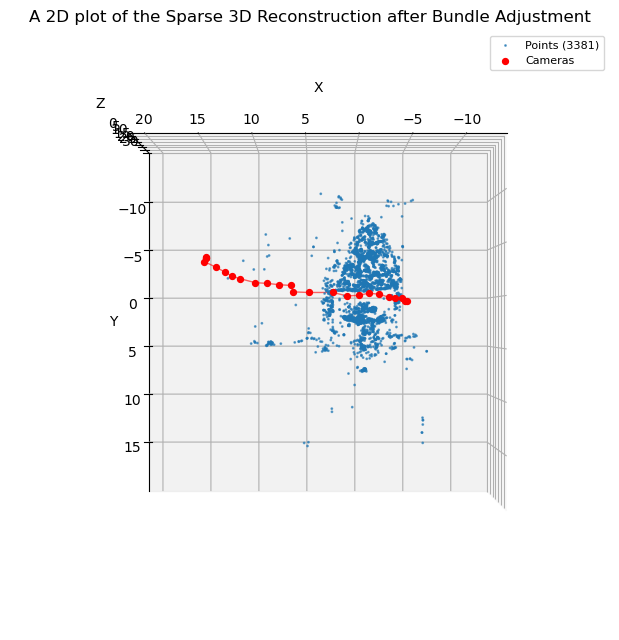

In [13]:
# Normalize obs
normalize_obs_inplace(tracks, cameras)

wh = guess_image_size_from_obs(tracks)
if wh:
    print(f"Obs imply ~width={wh[0]:.0f}+1, height={wh[1]:.0f}+1 (approx)")

# Check initial RMSE with correct K
rmse_initial, n_initial = _reprojection_rmse(cameras, tracks, K)
#print(f"Initial RMSE with correct K: {rmse_initial:.2f}px ({n_initial} measurements)")

# Filter (dedup + parallax)
tracks_ba = prepare_tracks_for_ba_strict(tracks, cameras, min_distinct_cams=2, min_angle_deg=1.0)

# Run BA with correct K
rmse_b, rmse_a, result, graph = run_bundle_adjustment_gtsam(
    cameras, tracks_ba, K, verbose=False, max_iters=100, weak_point_prior_sig=0.5
)

#print(f"Reprojection RMSE: before={rmse_b:.2f}px | after={rmse_a:.2f}px")


def _cam_centers_world(cameras):
    return np.array([np.asarray(cameras[i]['t'], float).ravel()
                     for i in sorted(cameras.keys())]) if cameras else np.zeros((0,3))


def _axis_equal_3d(ax, X):
    if X.size == 0: return
    mins = X.min(axis=0); maxs = X.max(axis=0)
    ctr  = (mins + maxs)/2.0
    r    = (maxs - mins).max() * 0.55
    ax.set_xlim(ctr[0]-r, ctr[0]+r)
    ax.set_ylim(ctr[1]-r, ctr[1]+r)
    ax.set_zlim(ctr[2]-r, ctr[2]+r)
    try: ax.set_box_aspect((1,1,1))
    except Exception: pass

def _reorder_and_flip(X, order=("x","y","z"), flips=("y",)):
    # map axis names to columns
    col = {"x":0, "y":1, "z":2}
    Y = X[:, [col[a] for a in order]].copy()
    for a in flips:
        Y[:, order.index(a)] *= -1
    return Y, order
    
def plot_sparse_map_3d_after_BA(
    cameras, tracks, max_points=120000, title="Sparse 3D Reconstruction",
    axis_order=("x","y","z"), flips=("y",), elev=30, azim=-135
):
    # points
    Xs = [d['X'] for d in tracks.values()]
    if not Xs:
        print("No points to plot."); return
    X = np.asarray(Xs)
    if len(X) > max_points:
        X = X[np.random.choice(len(X), size=max_points, replace=False)]

    # cameras
    C = _cam_centers_world(cameras)

    # apply axis reorder + flips
    Xv, order = _reorder_and_flip(X, axis_order, flips)
    Cv, _     = _reorder_and_flip(C, axis_order, flips) if C.size else (C, order)

    fig = plt.figure(figsize=(7.5, 6.5))
    ax = fig.add_subplot(111, projection='3d')

    ax.scatter(Xv[:,0], Xv[:,1], Xv[:,2], s=1, alpha=0.65, label=f'Points ({len(X)})')
    if Cv.size:
        ax.scatter(Cv[:,0], Cv[:,1], Cv[:,2], s=18, c='r', depthshade=False, label='Cameras')
        ax.plot(Cv[:,0], Cv[:,1], Cv[:,2], linewidth=1.0, alpha=0.6, c='r')

    ax.set_xlabel(order[0].upper()); ax.set_ylabel(order[1].upper()); ax.set_zlabel(order[2].upper())
    ax.set_title(title); ax.grid(True, alpha=0.25); ax.legend(loc='upper right', fontsize=8)

    both = Xv if not Cv.size else np.vstack([Xv, Cv])
    _axis_equal_3d(ax, both)
    ax.view_init(elev=elev, azim=azim)   
    plt.tight_layout(); plt.show()


plot_sparse_map_3d_after_BA(
    result['cameras'], result['tracks'],
    title="A 2D plot of the Sparse 3D Reconstruction after Bundle Adjustment",
    axis_order=("x","z","y"),   # Y up
    flips=(),                   # no sign flip
    elev=180, azim=90
)



In [14]:
# Interactive 3D viewer (Plotly)
import plotly.graph_objs as go
from plotly.offline import plot as plotly_save_html

def _cam_centers_world(cameras):
    C = []
    for idx in sorted(cameras.keys()):
        t = np.asarray(cameras[idx]['t'], float).reshape(3)
        C.append(t)
    return np.vstack(C) if C else np.zeros((0,3))


def _reorder_and_flip(X, order=("x","y","z"), flips=("y",)):
    idx = {"x":0, "y":1, "z":2}
    out = X[:, [idx[a] for a in order]].copy()
    for ax in flips:
        out[:, order.index(ax)] *= -1
    return out, order

def _axis_bounds_equal(X):
    # Return (center, half_range) for equal aspect.
    mins = X.min(axis=0); maxs = X.max(axis=0)
    ctr  = (mins + maxs) / 2.0
    r    = max(1e-9, (maxs - mins).max() * 0.55)
    return ctr, r

def _camera_axes_segments(C, R, scale=0.05):
    # Return 3 colored axis segments in camera frame (x=red, y=green, z=blue).
    o = C.reshape(3,1)
    X = (o + scale * R[:, [0]]).ravel()
    Y = (o + scale * R[:, [1]]).ravel()
    Z = (o + scale * R[:, [2]]).ravel()
    return X, Y, Z  # endpoints for each axis

def plot_sparse_map_3d_interactive(
    cameras, tracks, 
    max_points=120000, 
    axis_order=("x","y","z"), flips=("y",),
    show_cam_axes=True, cam_axis_scale=0.05,
    title="Sparse 3D Reconstruction (Interactive)",
    save_html_path=None   
):
    # Points
    Xs = [np.asarray(d['X'], float).reshape(3) for d in tracks.values() if 'X' in d]
    if not Xs:
        print("No points to plot."); 
        return
    X = np.vstack(Xs)
    if len(X) > max_points:
        sel = np.random.choice(len(X), size=max_points, replace=False)
        X = X[sel]

    # Cameras
    Cw = _cam_centers_world(cameras)

    # Reorder and flip
    Xv, order = _reorder_and_flip(X, axis_order, flips)
    Cv, _     = _reorder_and_flip(Cw, axis_order, flips) if Cw.size else (Cw, order)

    # Base point cloud trace
    pts_trace = go.Scatter3d(
        x=Xv[:,0], y=Xv[:,1], z=Xv[:,2],
        mode='markers',
        marker=dict(size=1.5, opacity=0.8),
        name=f'Points ({len(Xv)})'
    )

    traces = [pts_trace]

    # Camera centers trace
    if Cv.size:
        cam_trace = go.Scatter3d(
            x=Cv[:,0], y=Cv[:,1], z=Cv[:,2],
            mode='markers+lines',
            marker=dict(size=4, symbol='circle', opacity=0.95),
            line=dict(width=1),
            name='Cameras (centers)'
        )
        traces.append(cam_trace)

        if show_cam_axes:
            # Build per-camera axis segments
            xs, ys, zs, colors, names = [], [], [], [], []
            for idx in sorted(cameras.keys()):
                Rw = np.asarray(cameras[idx]['R'], float)
                tw = np.asarray(cameras[idx]['t'], float).reshape(3,1)
                Cw_i = (-Rw.T @ tw).ravel()
                Cvi, _ = _reorder_and_flip(Cw_i.reshape(1,3), axis_order, flips)
                Rv = Rw.copy()
                cols = {"x":0, "y":1, "z":2}
                Rv = Rv[:, [cols[a] for a in axis_order]]
                flip_sign = np.ones(3)
                for a in flips:
                    flip_sign[axis_order.index(a)] *= -1
                Rv = Rv * flip_sign.reshape(1,3)

                Xend, Yend, Zend = _camera_axes_segments(Cvi.ravel(), Rv, scale=cam_axis_scale)
                xs += [Cvi[0,0], Xend[0], None, Cvi[0,0], Yend[0], None, Cvi[0,0], Zend[0], None]
                ys += [Cvi[0,1], Xend[1], None, Cvi[0,1], Yend[1], None, Cvi[0,1], Zend[1], None]
                zs += [Cvi[0,2], Xend[2], None, Cvi[0,2], Yend[2], None, Cvi[0,2], Zend[2], None]

            axes_trace = go.Scatter3d(
                x=xs, y=ys, z=zs,
                mode='lines',
                line=dict(width=3),  
                name='Camera axes'
            )
            traces.append(axes_trace)

    both = Xv if not Cv.size else np.vstack([Xv, Cv])
    ctr, r = _axis_bounds_equal(both)

    layout = go.Layout(
        title=title,
        showlegend=True,
        scene=dict(
            xaxis=dict(title=order[0].upper(), range=[ctr[0]-r, ctr[0]+r]),
            yaxis=dict(title=order[1].upper(), range=[ctr[1]-r, ctr[1]+r]),
            zaxis=dict(title=order[2].upper(), range=[ctr[2]-r, ctr[2]+r]),
            aspectmode='data',  
            dragmode='orbit'
        ),
        margin=dict(l=0, r=0, t=40, b=0)
    )

    fig = go.Figure(data=traces, layout=layout)    
    fig.show()

    if save_html_path:
        plotly_save_html(fig, filename=save_html_path, auto_open=False)
        print(f"Saved interactive HTML to: {save_html_path}")


plot_sparse_map_3d_interactive(
    result['cameras'], 
    result['tracks'], 
    axis_order=("x","y","z"), 
    flips=("y",),                
    show_cam_axes=True, 
    cam_axis_scale=0.05,          
    title="An interactive 3D plot of the Sparse 3D Reconstruction after Bundle Adjustment",
    save_html_path="sparse_3d_after_ba.html"  
)



Saved interactive HTML to: sparse_3d_after_ba.html
